# Assignment 4

#### Christopher W. Hong

## The Road Ahead

I break the notebook into separate steps. Feel free to use the links below to navigate the notebook.

- [1. Binary classification](#1):
    - [a. Subsetting dogs and cats](#1a)
    - [b. Define train, validatin and test data denerators](#1b)
    - [c. Build a convolutional neural network](#1c)
    - [d. Evaluate performance and tune hyperparameters](#1d)
    - [e. Visualize the activations of the convolution layers](#1e)
    - [f. Visualize the filters](#1f)
    - [g.Transfer learning using VGG16](#1g)
    - [h. Fine-tune the convolutional base](#1h)
    - [i. Retrain the fine-tuned vgg16 model with augmented data](#1i)
    
- [2. Multiclass classification](#2)
    - [a. Download CIFAR-10](#2a)
    - [b. Build a basic convnet](#2b)
    - [c. Evaluate model performance and fine-tuning](#2c)
    - [d. Add inception blocks](#2d)
    - [e. Add residual blocks](#2e)

Feel free to skip **1a**, this part only setsup train, validation and test directories of dogs and cats.

Please **specify** the train, validation and test directories in **1b** for data generators.

In [1]:
from __future__ import print_function

import os, shutil
import numpy as np

import keras
import tensorflow as tf

from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten, BatchNormalization, Dropout
from keras.layers import Conv2D, MaxPooling2D
from keras.optimizers import RMSprop

from keras.preprocessing import image
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from keras.models import load_model
from keras.models import Model
from keras import backend as K

from keras.datasets import cifar10
from sklearn.model_selection import train_test_split
from keras.layers import Input, Add, AveragePooling2D, GlobalMaxPooling2D


import time
from PIL import Image as pil_image
from keras.preprocessing.image import save_img

import warnings
warnings.filterwarnings('ignore')

Using TensorFlow backend.


<a id='1'></a>
## 1. Binary classification

<a id='1a'></a>
### (a) Subsetting dogs and cats

* Feel free to skip to part **(b)**. This part only sets up the directory of the train, validation and test dogs and cats directories.

In [2]:
import os, shutil

def make_dir():
    """
    Setup original dogs and cats dataset dir.
    Create dogs and cats subset dir in current dir.
    Create train, validation and test dir in in previous dir.
    Create dogs and cats dir in previous dir.
    Return train_dir, validation_dir, test_dir
    """
    # Home directory
    home_dir = os.getenv('HOME')

    # Dogs and cats directory
    dogs_and_cats_dir = os.path.join(home_dir, 'Downloads/dogs-vs-cats/train')

    # Dogs and cats subset directory
    dogs_and_cats_subset_dir = os.path.join(os.getcwd(), 'dogs_and_cats_subset')

    # Train dogs and cats dir
    train_dir = os.path.join(dogs_and_cats_subset_dir, 'train')
    train_dogs_dir = os.path.join(train_dir, 'dogs')
    train_cats_dir = os.path.join(train_dir, 'cats')

    # Validation dogs and cats dir
    validation_dir = os.path.join(dogs_and_cats_subset_dir, 'validation')
    validation_dogs_dir = os.path.join(validation_dir, 'dogs')
    validation_cats_dir = os.path.join(validation_dir, 'cats')

    # test dogs and cats dir
    test_dir = os.path.join(dogs_and_cats_subset_dir, 'test')
    test_dogs_dir = os.path.join(test_dir, 'dogs')
    test_cats_dir = os.path.join(test_dir, 'cats')
    
    try:
        # Make dogs and cats subset dir
        os.mkdir(DOGS_AND_CATS_SUBSET_DIR)

        # Make train dogs and cats dir
        os.mkdir(train_dir)
        os.mkdir(train_dogs_dir)
        os.mkdir(train_cats_dir)

        # Make validation dogs and cats dir
        os.mkdir(validation_dir)
        os.mkdir(validation_dogs_dir)
        os.mkdir(validation_cats_dir)

        # Make test dogs and cats dir
        os.mkdir(test_dir)
        os.mkdir(test_dogs_dir)
        os.mkdir(test_cats_dir)
    except:
        print('Dirs exists')
        
    return train_dir, validation_dir, test_dir
    
def copy_images(img_name, src_dir, dst_dir, from_img_num, to_img_num):
    """
    Copy images from src dir to dst dir.
    """
    try:
        fnames = ['{}.{}.jpg'.format(img_name, i) for i in range(from_img_num, to_img_num)]
        for fname in fnames:
            src = os.path.join(src_dir, fname)
            dst = os.path.join(dst_dir, fname)
            shutil.copyfile(src, dst)
    except:
        print('Image/Path name error.')

In [31]:
# Make train, validation and test dogs and cats dir in current dir, respectively
train_dir, validation_dir, test_dir = make_dir()

# Copy dogs and cats to train, validation and test dir from src dir, respectively
copy_images('dog', dogs_and_cats_dir, train_dogs_dir, 0, 2000)
copy_images('dog', dogs_and_cats_dir, validation_dogs_dir, 2000, 4000)
copy_images('dog', dogs_and_cats_dir, test_dogs_dir, 4000, 6000)

copy_images('cat', dogs_and_cats_dir, train_cats_dir, 0, 2000)
copy_images('cat', dogs_and_cats_dir, validation_cats_dir, 2000, 4000)
copy_images('cat', dogs_and_cats_dir, test_cats_dir, 4000, 6000)

In [32]:
try:
    print('total training dog images:', len(os.listdir(train_dogs_dir)))
    print('total validation dog images:', len(os.listdir(validation_dogs_dir)))
    print('total test dogs images:', len(os.listdir(test_dogs_dir)))
    print('total training cat images:', len(os.listdir(train_cats_dir)))
    print('total validation cat images:', len(os.listdir(validation_cats_dir)))
    print('total test cat images:', len(os.listdir(test_cats_dir)))
except:
    print('Dir does not exist')

total training dog images: 2000
total validation dog images: 2000
total test dogs images: 2000
total training cat images: 2000
total validation cat images: 2000
total test cat images: 2000


<a id='1b'></a>
### (b) Define train, validatin and test data denerators

* Feel free to **specifiy** the `train_dir, validation_dir, and test_dir` below before testing the following code

In [2]:
import os

train_dir = os.path.join(os.getcwd(), 'dogs_and_cats_subset', 'train')
validation_dir = os.path.join(os.getcwd(), 'dogs_and_cats_subset', 'validation')
test_dir = os.path.join(os.getcwd(), 'dogs_and_cats_subset', 'test')

In [3]:
# Create train and test image data generator objects
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

# Setup train, validation and test data generators
try:
    train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(150,150),
        batch_size=20,
        class_mode='binary')

    validation_generator = test_datagen.flow_from_directory(
        validation_dir,
        target_size=(150,150),
        batch_size=20,
        class_mode='binary')

    test_generator = test_datagen.flow_from_directory(
        test_dir,
        target_size=(150,150),
        batch_size=20,
        class_mode='binary')
except:
    print('Please check train, validation and test dirs')

Found 4000 images belonging to 2 classes.
Found 4000 images belonging to 2 classes.
Found 4000 images belonging to 2 classes.


In [3]:
for data_batch, labels_batch in train_generator:
    print('data batch shape:', data_batch.shape)
    print('labels batch shape:', labels_batch.shape)
    break

data batch shape: (20, 150, 150, 3)
labels batch shape: (20,)


<a id='1c'></a>
### (c) Build a convolutional neural network

In [69]:
def build_model(n_hidden_fc1=128, n_hidden_fc2=64, dropout_rate=0.2, optimizer=RMSprop(learning_rate=1e-4)):
    model = Sequential([
        # CONV -> BN -> RELU
        Conv2D(32, 7, padding='same', input_shape=(150,150,3)),
        BatchNormalization(),
        Activation('relu'),

        # MaxPOOL
        MaxPooling2D(2),

        # CONV -> BN -> RELU
        Conv2D(64, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),

        # MaxPOOL
        MaxPooling2D(2),

        # CONV -> BN -> RELU
        Conv2D(128, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),

        # MaxPOOL
        MaxPooling2D(2),

        # FLATTEN -> FC -> DROUPOUT -> FC -> DROUPTOUT -> SIGMOID
        Flatten(),
        Dense(n_hidden_fc1, activation='relu'),
        Dropout(rate=dropout_rate),
        Dense(n_hidden_fc2, activation='relu'),
        Dropout(rate=dropout_rate),
        Dense(1, activation='sigmoid')
    ])

    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['acc'])
    
    return model

In [5]:
# Build model
model = build_model()
model.summary()


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 150, 150, 32)      4736      
_________________________________________________________________
batch_normalization_1 (Batch (None, 150, 150, 32)      128       
_________________________________________________________________
activation_1 (Activation)    (None, 150, 150, 32)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 75, 75, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 75, 75, 64)        18496     
_________________________________________________________________
batch_normalization_2 (Batch (None, 75, 75, 64)        256       
_________________________

In [6]:
# Train the model
history = model.fit_generator(
    train_generator,
    steps_per_epoch=100,
    epochs=30,
    validation_data=validation_generator,
    validation_steps=100)


Epoch 1/30
100/100 [==============================] - 163s 2s/step - loss: 0.9448 - acc: 0.5245 - val_loss: 0.7272 - val_acc: 0.4880
Epoch 2/30
100/100 [==============================] - 166s 2s/step - loss: 0.6983 - acc: 0.5620 - val_loss: 0.7759 - val_acc: 0.5120
Epoch 3/30
100/100 [==============================] - 173s 2s/step - loss: 0.6551 - acc: 0.6250 - val_loss: 1.0667 - val_acc: 0.4955
Epoch 4/30
100/100 [==============================] - 174s 2s/step - loss: 0.6266 - acc: 0.6340 - val_loss: 0.7929 - val_acc: 0.5595
Epoch 5/30
100/100 [==============================] - 178s 2s/step - loss: 0.5942 - acc: 0.6675 - val_loss: 0.5042 - val_acc: 0.6380
Epoch 6/30
100/100 [==============================] - 166s 2s/step - loss: 0.5683 - acc: 0.7110 - val_loss: 0.4743 - val_acc: 0.6950
Epoch 7/30
100/100 [==============================] - 172s 2s/step - loss: 0.5368 - acc: 0.7265 - val_loss: 0.7844 - val_acc: 0.6460
Epoch 8/30
100/100 [==============================] - 168s 2s/step -

In [8]:
# Save the model
model.save('dogs_and_cats_subset_1.h5')

<a id='1d'></a>
### (d) Evaluate performance and tune hyperparameters

<a id='1d1'></a>
#### Evaluate performance

In [21]:
def plot_model_performance(history):
    """
    Plot the train vs. validation accuracy and loss, respectively.
    """
    acc = history.history['acc']
    val_acc = history.history['val_acc']
    
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    
    epochs = range(1, len(acc) + 1)
    
    plt.figure(figsize=(15,10))

    plt.plot(epochs, acc, 'bo', label='Training acc')
    plt.plot(epochs, val_acc, 'b', label='Validation acc')
    plt.grid(axis='y')
    plt.title('Training and validation accuracy', fontsize=15)
    plt.legend()

    plt.figure(figsize=(15,10))

    plt.plot(epochs, loss, 'bo', label='Training loss')
    plt.plot(epochs, val_loss, 'b', label='Validation loss')
    plt.grid(axis='y')
    plt.title('Training and validation loss', fontsize=15)
    plt.legend()

    plt.show();

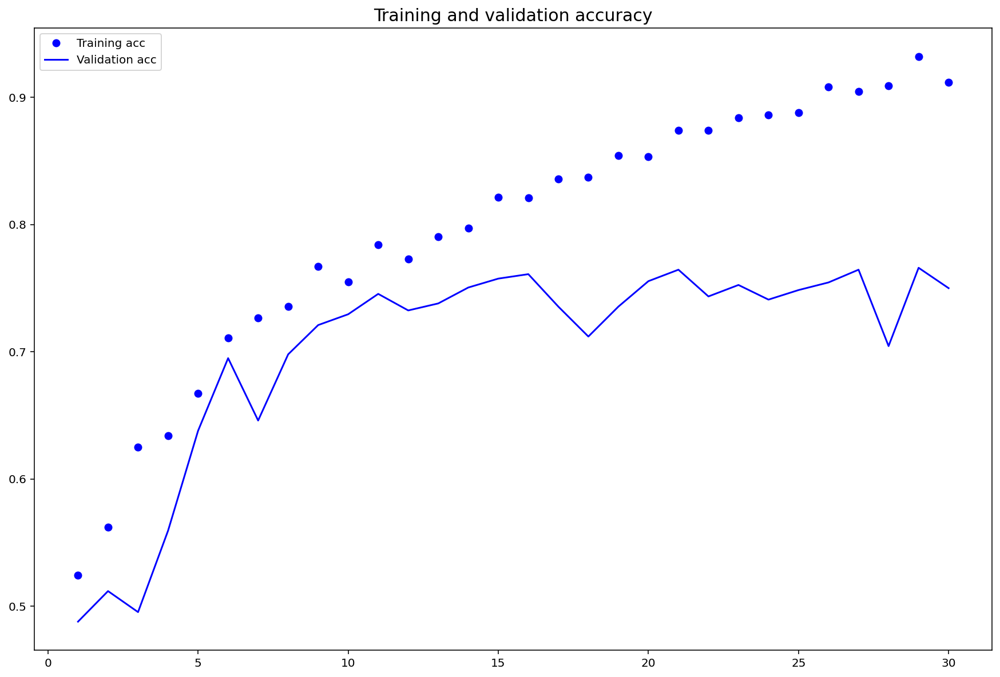

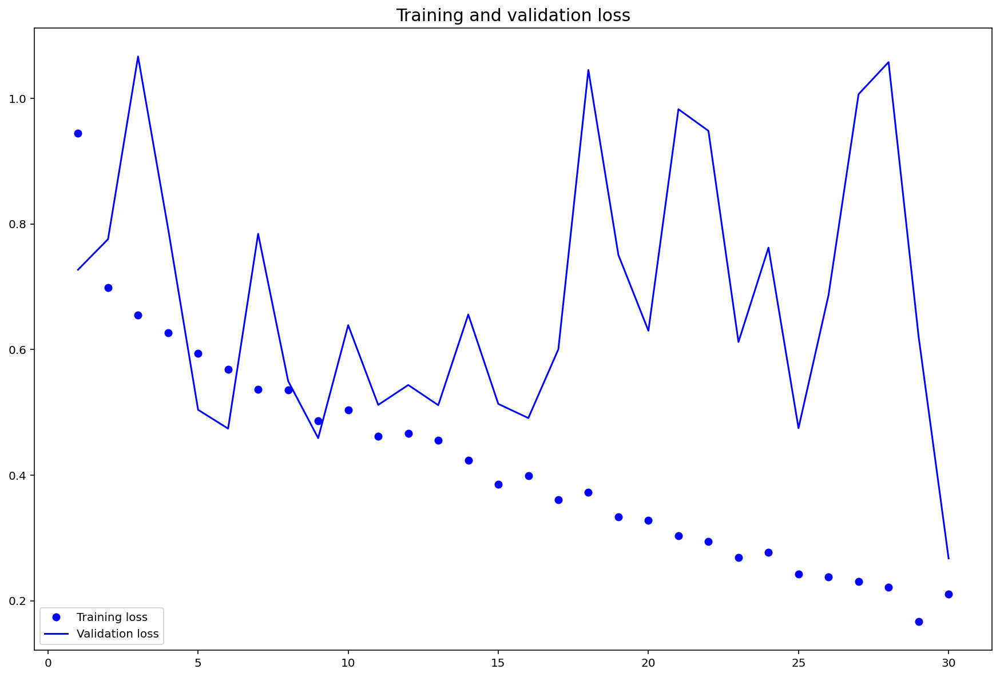

In [34]:
# Plot model performance
plot_model_performance(history)

<a id='1d2'></a>
#### Tune hyperparameters

In [63]:
model_tuned = build_model(dropout_rate=0.5)

In [64]:
history2 = model_tuned.fit_generator(
    train_generator,
    steps_per_epoch=100,
    epochs=20,
    validation_data=validation_generator,
    validation_steps=100)

Epoch 1/20
100/100 [==============================] - 157s 2s/step - loss: 1.0196 - acc: 0.5245 - val_loss: 0.7063 - val_acc: 0.5015
Epoch 2/20
100/100 [==============================] - 165s 2s/step - loss: 0.7093 - acc: 0.5350 - val_loss: 0.6949 - val_acc: 0.5290
Epoch 3/20
100/100 [==============================] - 162s 2s/step - loss: 0.6886 - acc: 0.5595 - val_loss: 0.7789 - val_acc: 0.5010
Epoch 4/20
100/100 [==============================] - 174s 2s/step - loss: 0.6794 - acc: 0.5390 - val_loss: 0.6957 - val_acc: 0.5010
Epoch 5/20
100/100 [==============================] - 161s 2s/step - loss: 0.6837 - acc: 0.5375 - val_loss: 0.6797 - val_acc: 0.5600
Epoch 6/20
100/100 [==============================] - 164s 2s/step - loss: 0.6839 - acc: 0.5705 - val_loss: 0.6341 - val_acc: 0.5795
Epoch 7/20
100/100 [==============================] - 165s 2s/step - loss: 0.6510 - acc: 0.5720 - val_loss: 0.6890 - val_acc: 0.5505
Epoch 8/20
100/100 [==============================] - 166s 2s/step - 

In [65]:
# Save the tune model
model_tuned.save('dogs_and_cats_subset_1_tuned.h5')

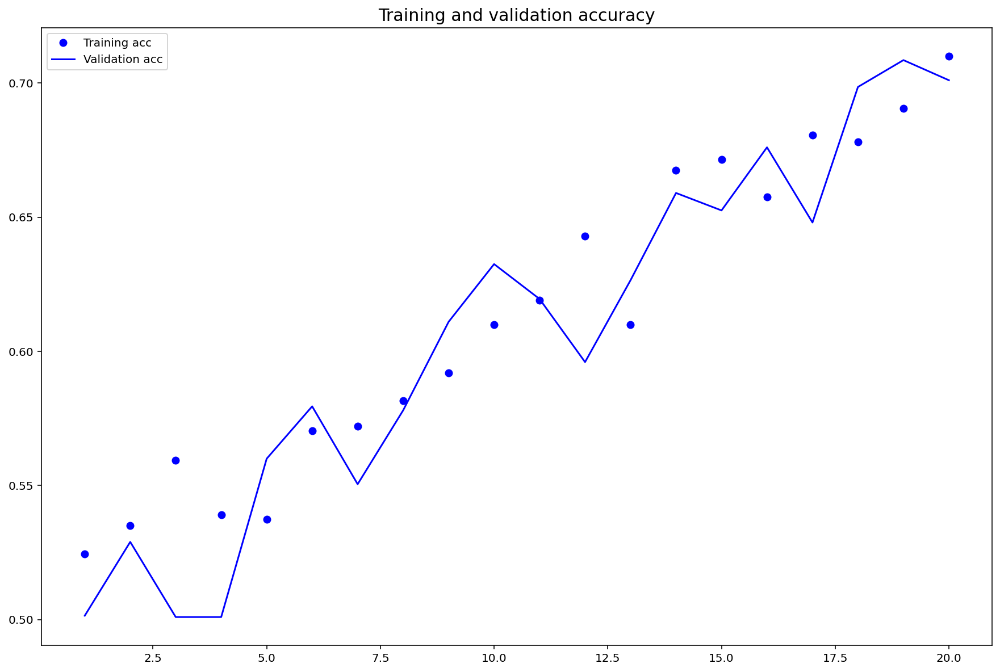

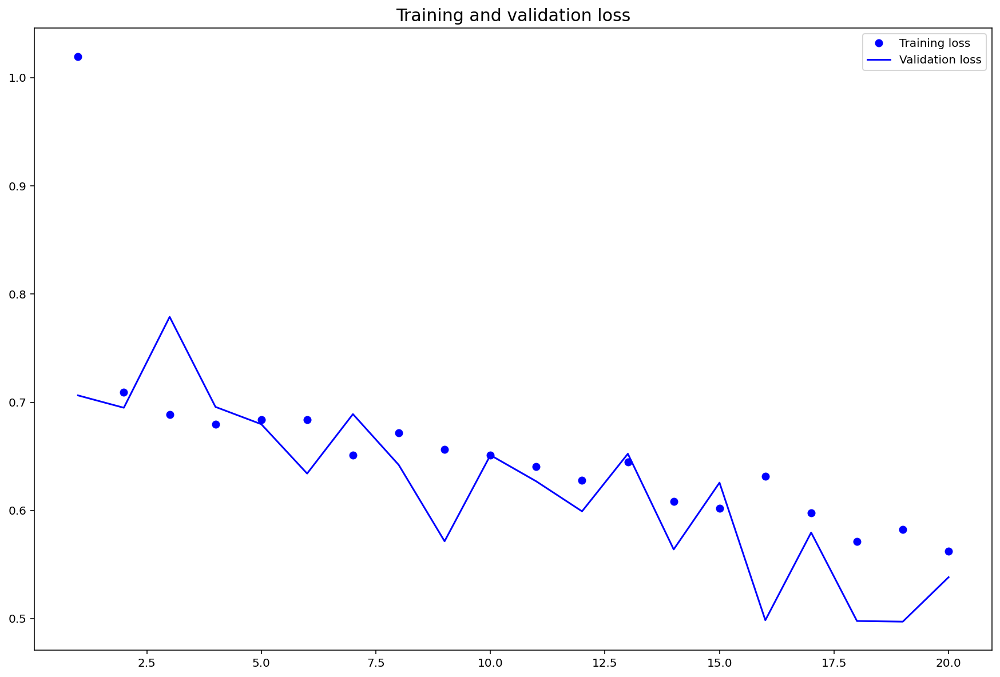

In [67]:
# Plot model performance
plot_model_performance(history2)

In [68]:
# Evaluate fine-tuned model performance in test data
model_tuned.evaluate_generator(test_generator, steps=100)

[0.5659316778182983, 0.6990000009536743]

<a id='1e'></a>
### (e) Visualize the activations of the convolution layers

<a id='1e1'></a>
#### Load pretrained model

In [65]:
# Load the model
try:
    model = load_model('dogs_and_cats_subset_1_tuned.h5')
except:
    print('dogs_and_cats_subset_1 model does not exist')
    
model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 150, 150, 32)      4736      
_________________________________________________________________
batch_normalization_7 (Batch (None, 150, 150, 32)      128       
_________________________________________________________________
activation_7 (Activation)    (None, 150, 150, 32)      0         
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 75, 75, 32)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 75, 75, 64)        18496     
_________________________________________________________________
batch_normalization_8 (Batch (None, 75, 75, 64)        256       
_________________________________________________________________
activation_8 (Activation)    (None, 75, 75, 64)       

<a id='1e2'></a>
#### Load an image

In [66]:
def load_img(img_path):
    """
    Load and display an image.
    """
    try:
        img = image.load_img(img_path, target_size=(150,150))
        img_tensor = image.img_to_array(img)
        img_tensor = np.expand_dims(img_tensor, axis=0)
        img_tensor /= 255.
        
        plt.imshow(img_tensor[0])
        plt.show();
        
        return img_tensor
    except:
        print('Incorrect image path') 

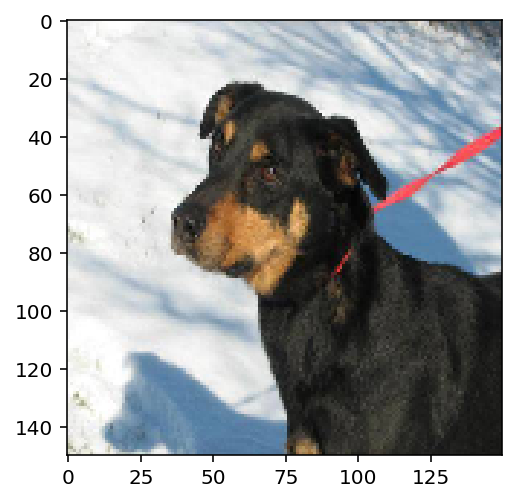

In [67]:
img_path = 'dogs_and_cats_subset/test/dogs/dog.5000.jpg'
img_tensor = load_img(img_path)

<a id='1e3'></a>
#### Visualize activations of the first convnet layer

first layer activation shape: (1, 150, 150, 32)


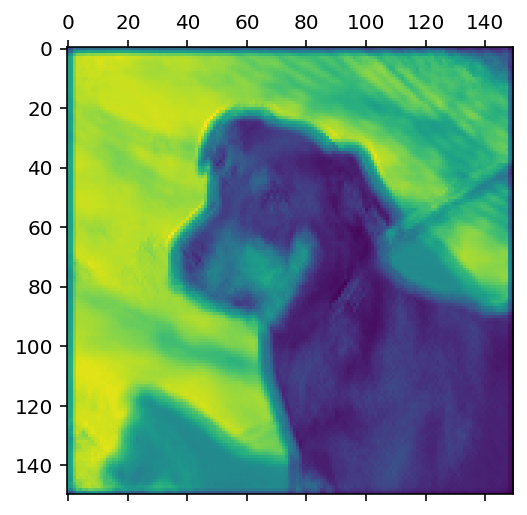

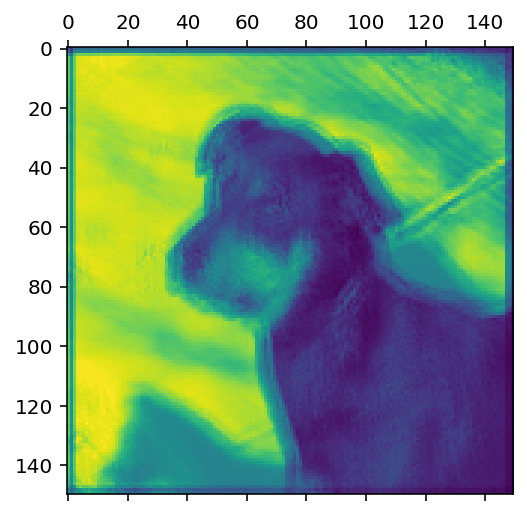

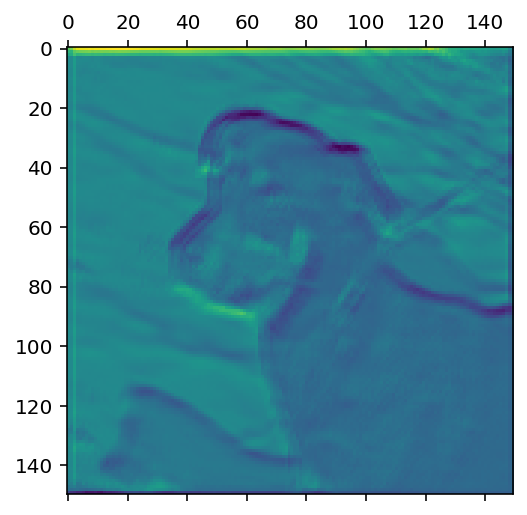

In [68]:
# Extracts the outpus of the top 6 layers
layer_outputs = [layer.output for layer in model.layers[:12]]

# Create a model that will return these outpus, given the model input
activation_model = Model(inputs=model.input, outputs=layer_outputs)

activations = activation_model.predict(img_tensor)

first_layer_activation = activations[0]
print('first layer activation shape:', first_layer_activation.shape)

# Plot the first, middle and last channel of the first convnet layer
plt.matshow(first_layer_activation[0, :, :, 0], cmap='viridis');
plt.matshow(first_layer_activation[0, :, :, 15], cmap='viridis');
plt.matshow(first_layer_activation[0, :, :, 31], cmap='viridis');

<a id='1e4'></a>
#### Visualize every channel in every conv2D/pooling layer

In [69]:
layer_names = []
for layer in model.layers[:12]:
        layer_names.append(layer.name)
layer_names

['conv2d_7',
 'batch_normalization_7',
 'activation_7',
 'max_pooling2d_7',
 'conv2d_8',
 'batch_normalization_8',
 'activation_8',
 'max_pooling2d_8',
 'conv2d_9',
 'batch_normalization_9',
 'activation_9',
 'max_pooling2d_9']

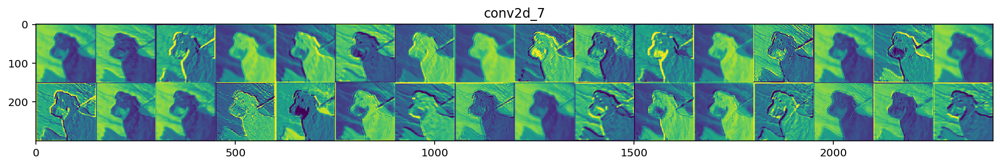

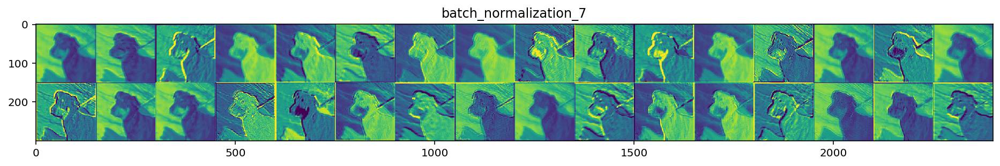

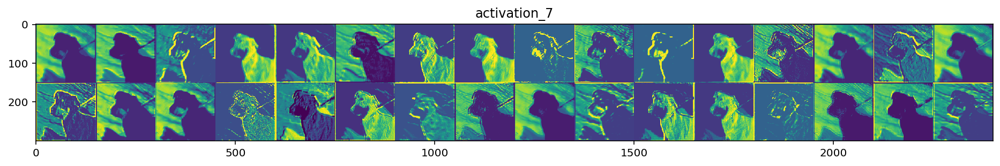

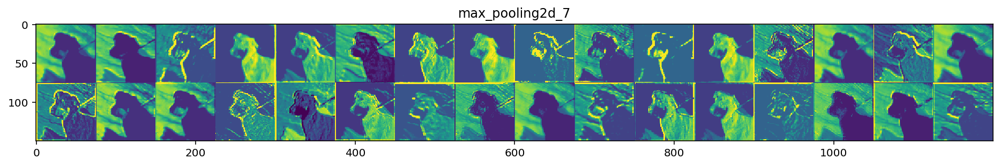

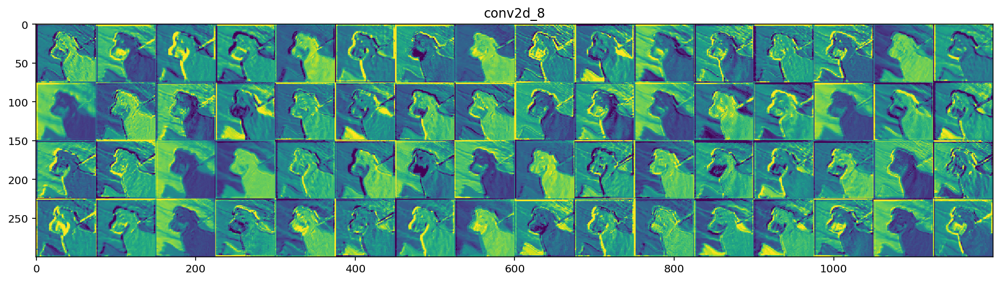

...

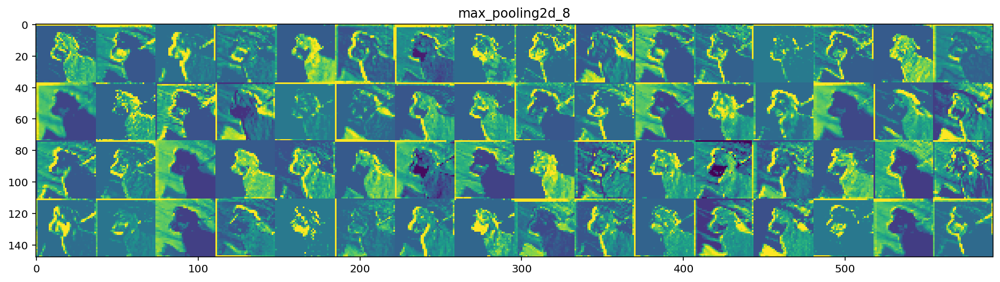

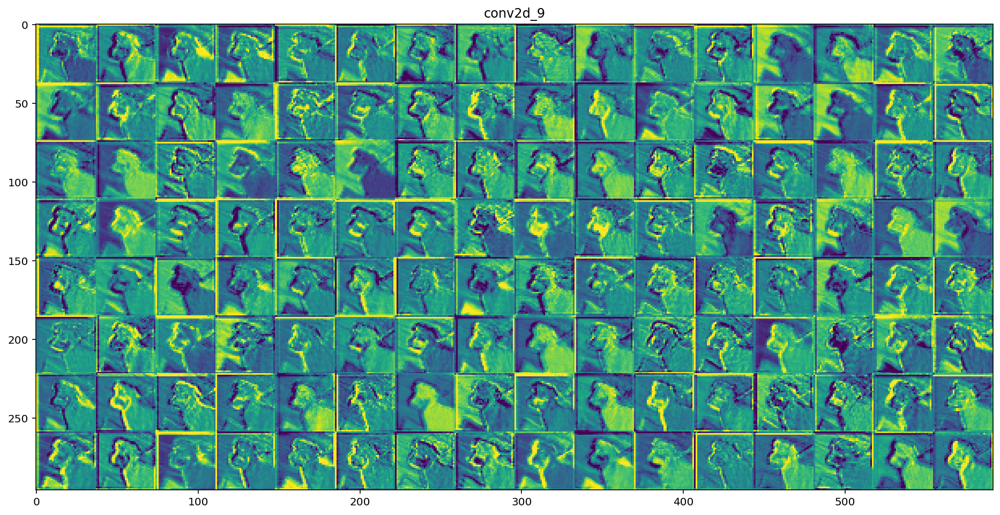

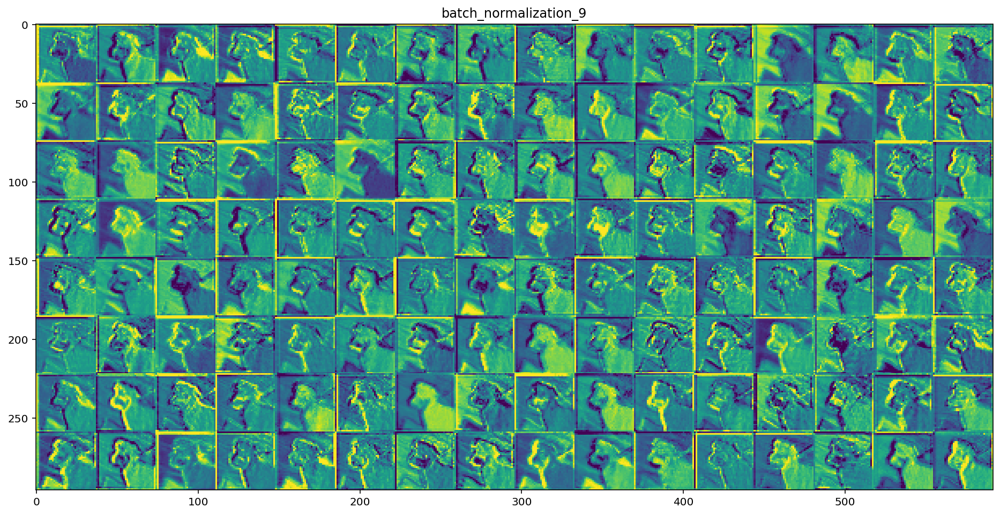

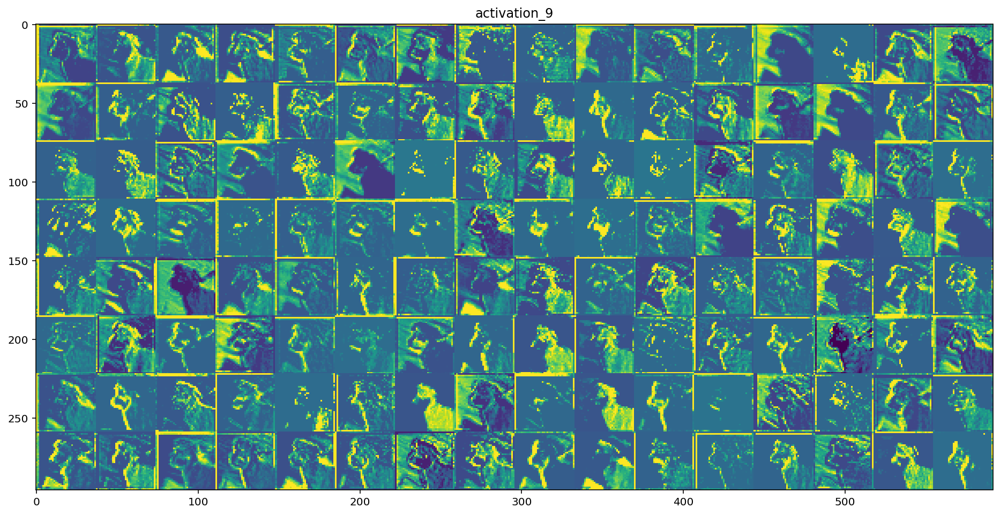

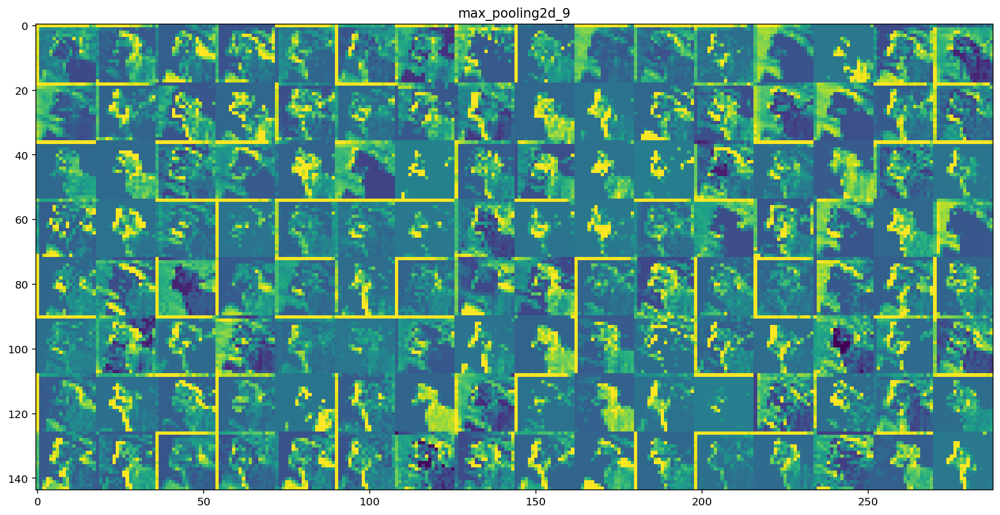

In [70]:
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    
    size = layer_activation.shape[1]
    
    n_cols = n_features // images_per_row
    
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :, col * images_per_row + row]
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size: (col + 1) * size, row * size: (row + 1) * size] = channel_image
            
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

<a id='1f'></a>
### (f) Visualize the filters

<a id='1f1'></a>
#### Generate a grid of all filter response patterns in the first layer

In [138]:
# This block of code is taken from Keras.io that is written by F. Chollet
def normalize(x):
    """utility function to normalize a tensor.

    # Arguments
        x: An input tensor.

    # Returns
        The normalized input tensor.
    """
    return x / (K.sqrt(K.mean(K.square(x))) + K.epsilon())


def deprocess_image(x):
    """utility function to convert a float array into a valid uint8 image.

    # Arguments
        x: A numpy-array representing the generated image.

    # Returns
        A processed numpy-array, which could be used in e.g. imshow.
    """
    # normalize tensor: center on 0., ensure std is 0.25
    x -= x.mean()
    x /= (x.std() + K.epsilon())
    x *= 0.25

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    if K.image_data_format() == 'channels_first':
        x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x


def process_image(x, former):
    """utility function to convert a valid uint8 image back into a float array.
       Reverses `deprocess_image`.

    # Arguments
        x: A numpy-array, which could be used in e.g. imshow.
        former: The former numpy-array.
                Need to determine the former mean and variance.

    # Returns
        A processed numpy-array representing the generated image.
    """
    if K.image_data_format() == 'channels_first':
        x = x.transpose((2, 0, 1))
    return (x / 255 - 0.5) * 4 * former.std() + former.mean()


def visualize_layer(model,
                    layer_name,
                    step=1.,
                    epochs=15,
                    upscaling_steps=9,
                    upscaling_factor=1.2,
                    output_dim=(412, 412),
                    filter_range=(0, None)):
    """Visualizes the most relevant filters of one conv-layer in a certain model.

    # Arguments
        model: The model containing layer_name.
        layer_name: The name of the layer to be visualized.
                    Has to be a part of model.
        step: step size for gradient ascent.
        epochs: Number of iterations for gradient ascent.
        upscaling_steps: Number of upscaling steps.
                         Starting image is in this case (80, 80).
        upscaling_factor: Factor to which to slowly upgrade
                          the image towards output_dim.
        output_dim: [img_width, img_height] The output image dimensions.
        filter_range: Tupel[lower, upper]
                      Determines the to be computed filter numbers.
                      If the second value is `None`,
                      the last filter will be inferred as the upper boundary.
    """

    def _generate_filter_image(input_img,
                               layer_output,
                               filter_index):
        """Generates image for one particular filter.

        # Arguments
            input_img: The input-image Tensor.
            layer_output: The output-image Tensor.
            filter_index: The to be processed filter number.
                          Assumed to be valid.

        #Returns
            Either None if no image could be generated.
            or a tuple of the image (array) itself and the last loss.
        """
        s_time = time.time()

        # we build a loss function that maximizes the activation
        # of the nth filter of the layer considered
        if K.image_data_format() == 'channels_first':
            loss = K.mean(layer_output[:, filter_index, :, :])
        else:
            loss = K.mean(layer_output[:, :, :, filter_index])

        # we compute the gradient of the input picture wrt this loss
        grads = K.gradients(loss, input_img)[0]

        # normalization trick: we normalize the gradient
        grads = normalize(grads)

        # this function returns the loss and grads given the input picture
        iterate = K.function([input_img], [loss, grads])

        # we start from a gray image with some random noise
        intermediate_dim = tuple(
            int(x / (upscaling_factor ** upscaling_steps)) for x in output_dim)
        if K.image_data_format() == 'channels_first':
            input_img_data = np.random.random(
                (1, 3, intermediate_dim[0], intermediate_dim[1]))
        else:
            input_img_data = np.random.random(
                (1, intermediate_dim[0], intermediate_dim[1], 3))
        input_img_data = (input_img_data - 0.5) * 20 + 128

        # Slowly upscaling towards the original size prevents
        # a dominating high-frequency of the to visualized structure
        # as it would occur if we directly compute the 412d-image.
        # Behaves as a better starting point for each following dimension
        # and therefore avoids poor local minima
        for up in reversed(range(upscaling_steps)):
            # we run gradient ascent for e.g. 20 steps
            for _ in range(epochs):
                loss_value, grads_value = iterate([input_img_data])
                input_img_data += grads_value * step

                # some filters get stuck to 0, we can skip them
                if loss_value <= K.epsilon():
                    return None

            # Calculate upscaled dimension
            intermediate_dim = tuple(
                int(x / (upscaling_factor ** up)) for x in output_dim)
            # Upscale
            img = deprocess_image(input_img_data[0])
            img = np.array(pil_image.fromarray(img).resize(intermediate_dim,
                                                           pil_image.BICUBIC))
            input_img_data = np.expand_dims(
                process_image(img, input_img_data[0]), 0)

        # decode the resulting input image
        img = deprocess_image(input_img_data[0])
        e_time = time.time()
        print('Costs of filter {:3}: {:5.0f} ( {:4.2f}s )'.format(filter_index,
                                                                  loss_value,
                                                                  e_time - s_time))
        return img, loss_value

    def _draw_filters(filters, n=None):
        """Draw the best filters in a nxn grid.

        # Arguments
            filters: A List of generated images and their corresponding losses
                     for each processed filter.
            n: dimension of the grid.
               If none, the largest possible square will be used
        """
        if n is None:
            n = int(np.floor(np.sqrt(len(filters))))

        # the filters that have the highest loss are assumed to be better-looking.
        # we will only keep the top n*n filters.
        filters.sort(key=lambda x: x[1], reverse=True)
        filters = filters[:n * n]

        # build a black picture with enough space for
        # e.g. our 8 x 8 filters of size 412 x 412, with a 5px margin in between
        MARGIN = 5
        width = n * output_dim[0] + (n - 1) * MARGIN
        height = n * output_dim[1] + (n - 1) * MARGIN
        stitched_filters = np.zeros((width, height, 3), dtype='uint8')

        # fill the picture with our saved filters
        for i in range(n):
            for j in range(n):
                img, _ = filters[i * n + j]
                width_margin = (output_dim[0] + MARGIN) * i
                height_margin = (output_dim[1] + MARGIN) * j
                stitched_filters[
                    width_margin: width_margin + output_dim[0],
                    height_margin: height_margin + output_dim[1], :] = img

        # save the result to disk
        save_img('filter_{0:}.png'.format(layer_name), stitched_filters)

    # this is the placeholder for the input images
    assert len(model.inputs) == 1
    input_img = model.inputs[0]

    # get the symbolic outputs of each "key" layer (we gave them unique names).
    layer_dict = dict([(layer.name, layer) for layer in model.layers[1:]])

    output_layer = layer_dict[layer_name]
    assert isinstance(output_layer, layers.Conv2D)

    # Compute to be processed filter range
    filter_lower = filter_range[0]
    filter_upper = (filter_range[1]
                    if filter_range[1] is not None
                    else len(output_layer.get_weights()[1]))
    assert(filter_lower >= 0
           and filter_upper <= len(output_layer.get_weights()[1])
           and filter_upper > filter_lower)
    print('Compute filters {:} to {:}'.format(filter_lower, filter_upper))

    # iterate through each filter and generate its corresponding image
    processed_filters = []
    for f in range(filter_lower, filter_upper):
        img_loss = _generate_filter_image(input_img, output_layer.output, f)

        if img_loss is not None:
            processed_filters.append(img_loss)

    print('{} filter processed.'.format(len(processed_filters)))
    # Finally draw and store the best filters to disk
    _draw_filters(processed_filters)

In [139]:
visualize_layer(model, layer_names[4])

Compute filters 0 to 64
Costs of filter   1:   231 ( 12.78s )
Costs of filter   6:   191 ( 12.70s )
Costs of filter  10:   102 ( 12.60s )
Costs of filter  13:   142 ( 12.38s )
Costs of filter  15:    91 ( 12.79s )
Costs of filter  16:   336 ( 12.48s )
Costs of filter  24:   157 ( 13.86s )
Costs of filter  26:   226 ( 13.48s )
Costs of filter  27:   221 ( 12.90s )
Costs of filter  28:   288 ( 12.80s )
Costs of filter  29:   210 ( 12.18s )
Costs of filter  30:    95 ( 12.10s )
Costs of filter  32:   182 ( 12.18s )
Costs of filter  34:   185 ( 12.33s )
Costs of filter  38:   191 ( 14.13s )
Costs of filter  39:   158 ( 15.10s )
Costs of filter  43:    99 ( 15.13s )
Costs of filter  46:   225 ( 15.77s )
Costs of filter  47:   263 ( 14.25s )
Costs of filter  50:   166 ( 14.00s )
Costs of filter  51:   118 ( 14.55s )
Costs of filter  57:   229 ( 15.46s )
Costs of filter  62:   204 ( 15.52s )
23 filter processed.


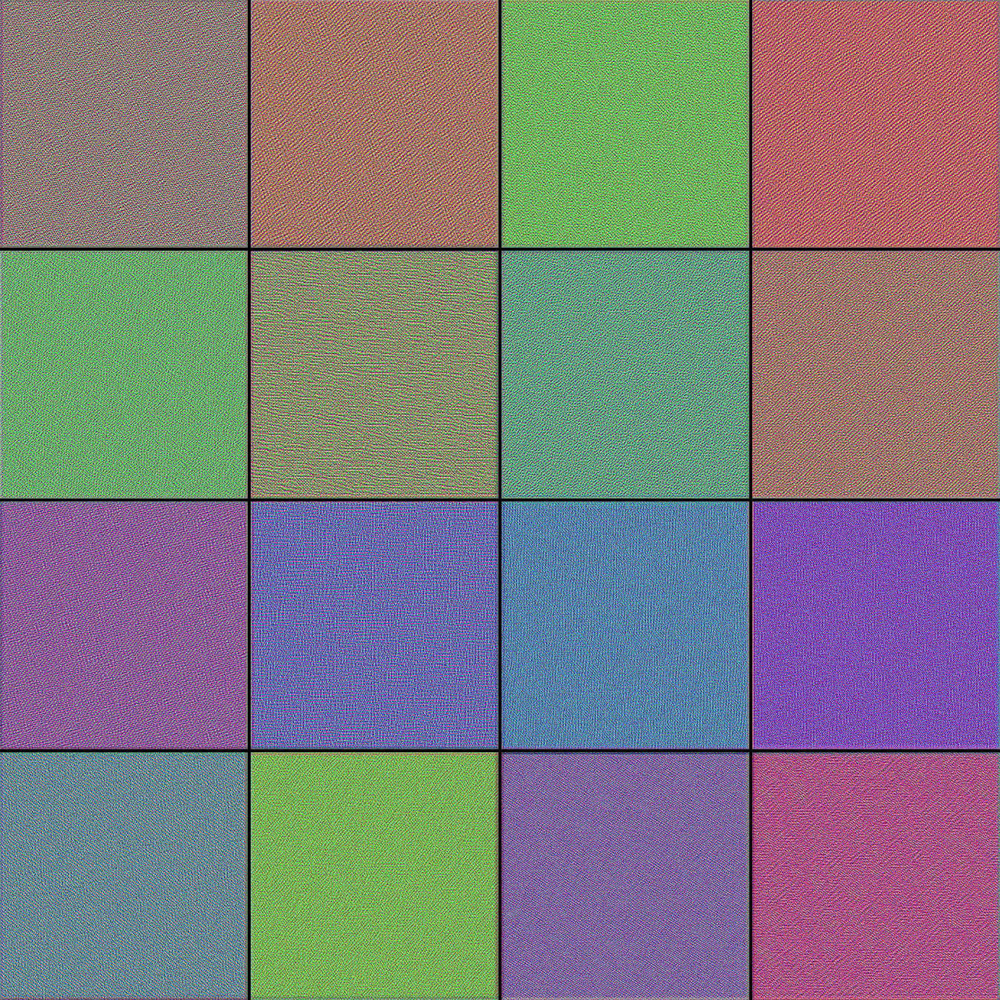

In [140]:
pil_image.open('filter_conv2d_8.png')

<a id='1g'></a>
### (g) Transfer learning using VGG16

<a id='1g1'></a>
#### Instantiate the VGG16 convolutional base

In [39]:
from keras. applications import VGG16

conv_base = VGG16(weights='imagenet',
                  include_top=False,
                  input_shape=(150, 150, 3))
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 150, 150, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0     

<a id='1g2'></a>
#### Add classifier on top of the convolutional base

In [40]:
def build_vgg16(conv_base,
                n_hidden_fc1=128, 
                n_hidden_fc2=64, 
                dropout_rate=0.2, 
                opt=RMSprop(learning_rate=1e-4)):
    """
    Build a classifer on top of the convlutional base.
    """
    model = Sequential([
        # conv base
        conv_base,

        # FLATTEN -> FC -> DROUPOUT -> FC -> DROUPTOUT -> SIGMOID
        Flatten(),
        Dense(n_hidden_fc1, activation='relu'),
        Dropout(rate=dropout_rate),
        Dense(n_hidden_fc2, activation='relu'),
        Dropout(rate=dropout_rate),
        Dense(1, activation='sigmoid')
    ])
    
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['acc'])
    
    return model

In [41]:
# Freeze the conv base
conv_base.trainable = False

model_vgg16 = build_vgg16(conv_base)
model_vgg16.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_6 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dense_16 (Dense)             (None, 128)               1048704   
_________________________________________________________________
dropout_11 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_17 (Dense)             (None, 64)                8256      
_________________________________________________________________
dropout_12 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_18 (Dense)             (None, 1)                

<a id='1g3'></a>
#### Train the model end to end with a frozen convolutional base

In [42]:
history3 = model_vgg16.fit_generator(
    train_generator,
    steps_per_epoch=100,
    epochs=30,
    validation_data=validation_generator,
    validation_steps=100)

Epoch 1/30
100/100 [==============================] - 32s 316ms/step - loss: 0.4683 - acc: 0.7670 - val_loss: 0.2463 - val_acc: 0.8695
Epoch 2/30
100/100 [==============================] - 31s 307ms/step - loss: 0.3440 - acc: 0.8480 - val_loss: 0.2050 - val_acc: 0.8720
Epoch 3/30
100/100 [==============================] - 30s 301ms/step - loss: 0.2765 - acc: 0.8815 - val_loss: 0.2516 - val_acc: 0.8615
Epoch 4/30
100/100 [==============================] - 30s 297ms/step - loss: 0.2767 - acc: 0.8885 - val_loss: 0.2227 - val_acc: 0.8860
Epoch 5/30
100/100 [==============================] - 30s 301ms/step - loss: 0.2399 - acc: 0.8995 - val_loss: 0.1563 - val_acc: 0.8925
Epoch 6/30
100/100 [==============================] - 31s 308ms/step - loss: 0.2266 - acc: 0.9055 - val_loss: 0.3505 - val_acc: 0.8615
Epoch 7/30
100/100 [==============================] - 31s 307ms/step - loss: 0.1999 - acc: 0.9140 - val_loss: 0.1423 - val_acc: 0.8835
Epoch 8/30
100/100 [==============================] - 3

In [47]:
# Save the tune model
model_vgg16.save('dogs_and_cats_subset_vgg16.h5')

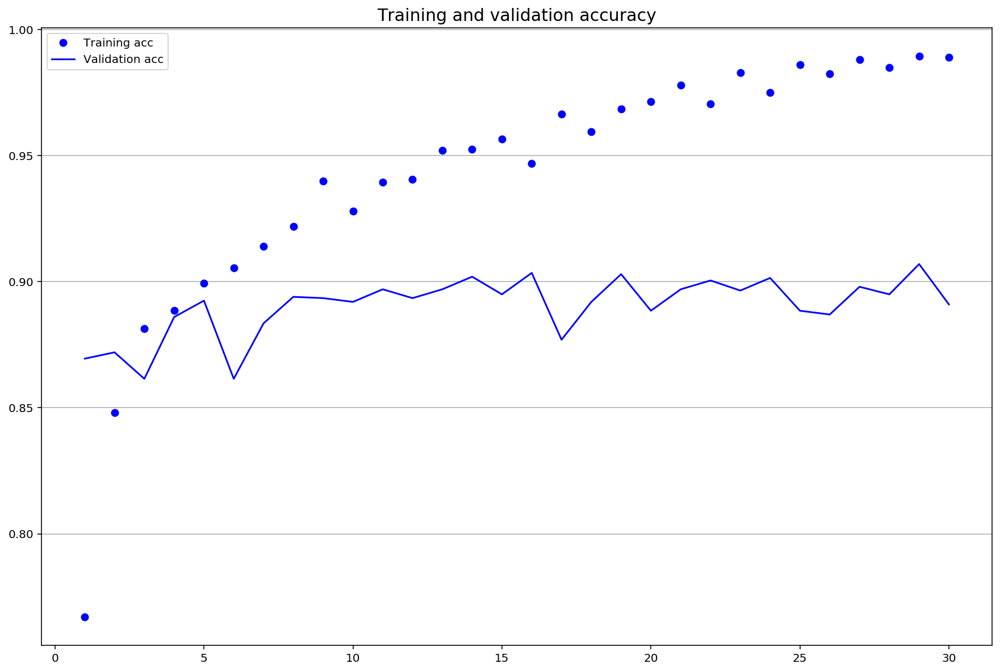

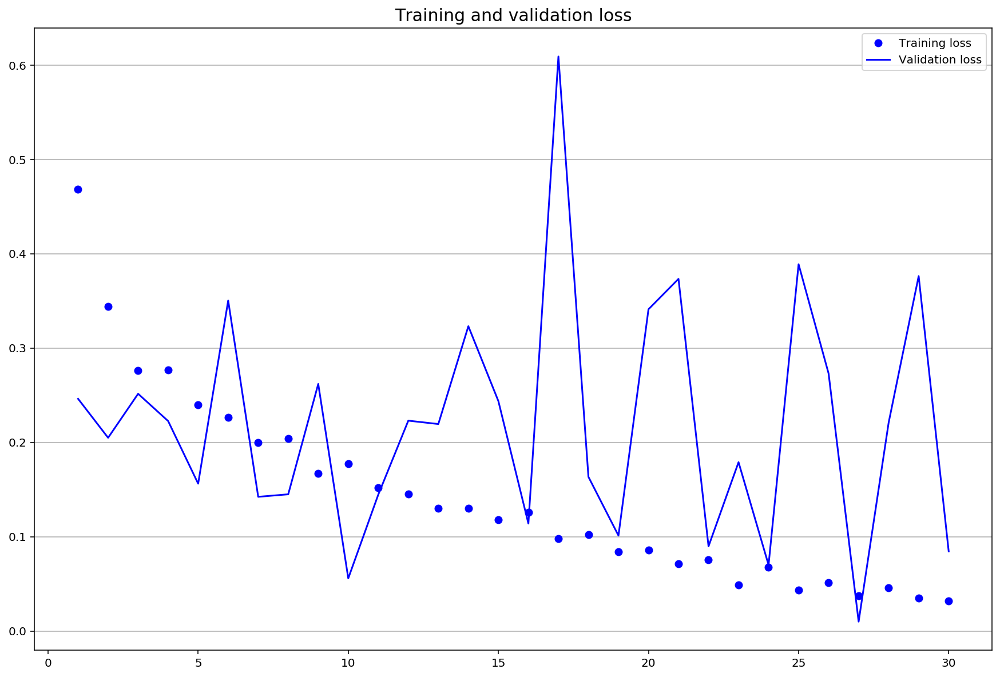

In [46]:
# Plot model performance
plot_model_performance(history3)

In [48]:
# Evaluate vgg16 model performance in test data
model_vgg16.evaluate_generator(test_generator, steps=100)

[0.5799105763435364, 0.9085000157356262]

<a id='1h'></a>
### (h) Fine-tune the convolutional base

<a id='1h1'></a>
#### Fine-tune Conv block5

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

Epoch 1/30
100/100 [==============================] - 36s 361ms/step - loss: 0.5449 - acc: 0.7095 - val_loss: 0.2980 - val_acc: 0.8460
Epoch 2/30
100/100 [==============================] - 33s 328ms/step - loss: 0.3669 - acc: 0.8430 - val_loss: 0.2213 - val_acc: 0.8750
Epoch 3/30
100/100 [==============================] - 33s 330ms/step - loss: 0.2510 - acc: 0.8925 - val_loss: 0.1048 - val_acc: 0.8955
Epoch 4/30
100/100 [==============================] - 33s 330ms/step - loss: 0.2166 - acc: 0.9140 - val_loss: 0.2270 - val_acc: 0.9095
Epoch 5/30
100/100 [==============================] - 33s 333ms/step - loss: 0.1844 - acc: 0.9295 - val_loss: 0.1233 - val_acc: 0.9010
Epoch 6/30
100/100 [==============================] - 33s 332ms/step - loss: 0.1637 - acc: 0.9340 - val_loss: 0.2258 - val_acc: 0.9145
Epoch 7/30
100/100 [==============================] - 33s 333ms/step - loss: 0.1391 - acc: 0.94

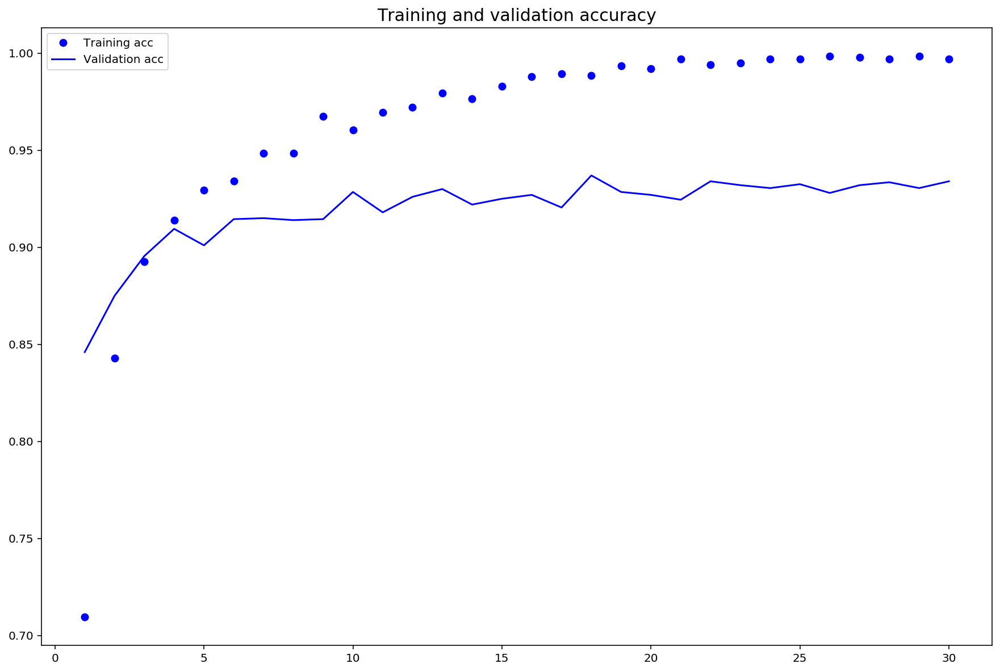

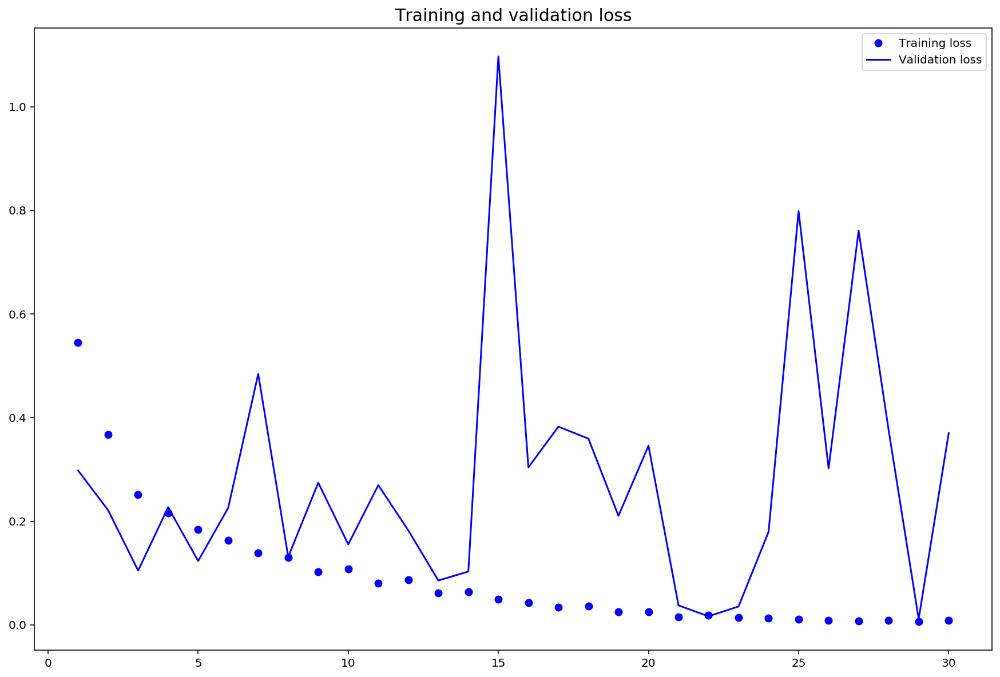

In [7]:
# Freeze to the conv base up to block4
conv_base.trainable = True

set_trainable = False
for layer in conv_base.layers:
    if layer.name == 'block5_conv1':
        set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False

# Train the tuned model
model_vgg16_tuned = build_vgg16(conv_base, opt=RMSprop(learning_rate=1e-5))

history4 = model_vgg16_tuned.fit_generator(
    train_generator,
    steps_per_epoch=100,
    epochs=30,
    validation_data=validation_generator,
    validation_steps=100)

# Save the tune model
model_vgg16_tuned.save('dogs_and_cats_subset_vgg16_tuned.h5')

# Plot model performance
plot_model_performance(history4)

In [9]:
# Evaluate vgg16 fine-tuned model performance in test data
model_vgg16_tuned.evaluate_generator(test_generator, steps=100)

[0.010463779792189598, 0.9440000057220459]

<a id='1i'></a>
### (i) Retrain the fine-tuned vgg16 model with augmented data

<a id='1i1'></a>
#### Data augmentation

In [14]:
# Only augment train dataset, while validation and test datasets stay as is
augmented_train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest')

augmented_train_generator = augmented_train_datagen.flow_from_directory(
    train_dir,
    target_size=(150,150),
    batch_size=20,
    class_mode='binary')

Found 4000 images belonging to 2 classes.


<a id='1i2'></a>
#### Train the fine-tuned vgg16 with augmented data

Epoch 1/30
100/100 [==============================] - 34s 336ms/step - loss: 0.2693 - acc: 0.9070 - val_loss: 0.2127 - val_acc: 0.9175
Epoch 2/30
100/100 [==============================] - 33s 329ms/step - loss: 0.2310 - acc: 0.9065 - val_loss: 0.0305 - val_acc: 0.9410
Epoch 3/30
100/100 [==============================] - 33s 329ms/step - loss: 0.1861 - acc: 0.9225 - val_loss: 0.1025 - val_acc: 0.9290
Epoch 4/30
100/100 [==============================] - 33s 327ms/step - loss: 0.2022 - acc: 0.9200 - val_loss: 0.1330 - val_acc: 0.9350
Epoch 5/30
100/100 [==============================] - 34s 339ms/step - loss: 0.1801 - acc: 0.9270 - val_loss: 0.4163 - val_acc: 0.9305
Epoch 6/30
100/100 [==============================] - 33s 329ms/step - loss: 0.1812 - acc: 0.9280 - val_loss: 0.0229 - val_acc: 0.9335
Epoch 7/30
100/100 [==============================] - 33s 332ms/step - loss: 0.1722 - acc: 0.9285 - val_loss: 0.0138 - val_acc: 0.9320
Epoch 8/30
100/100 [==============================] - 3

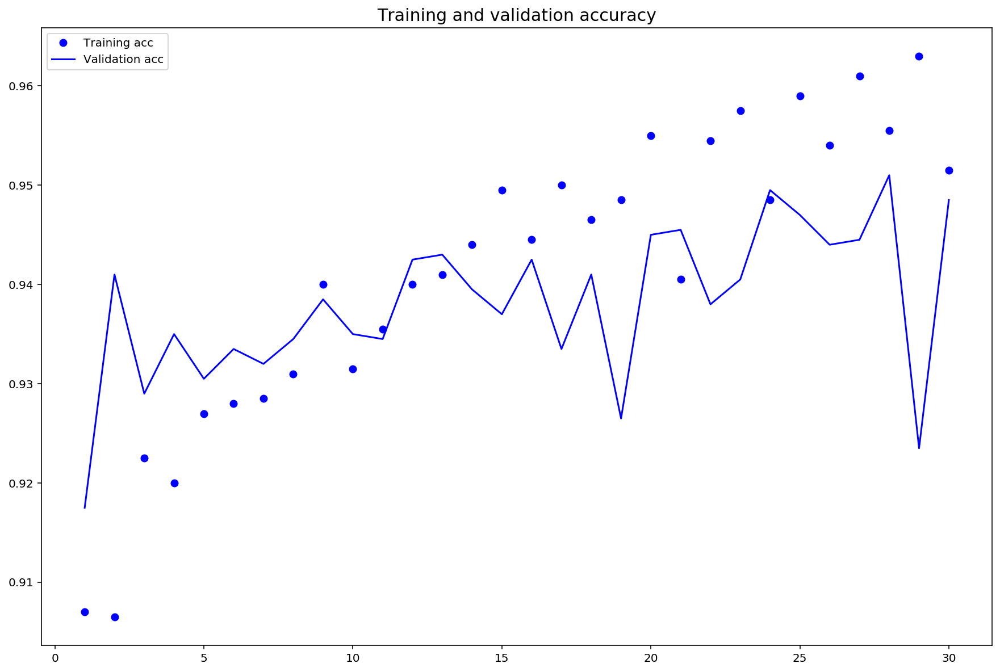

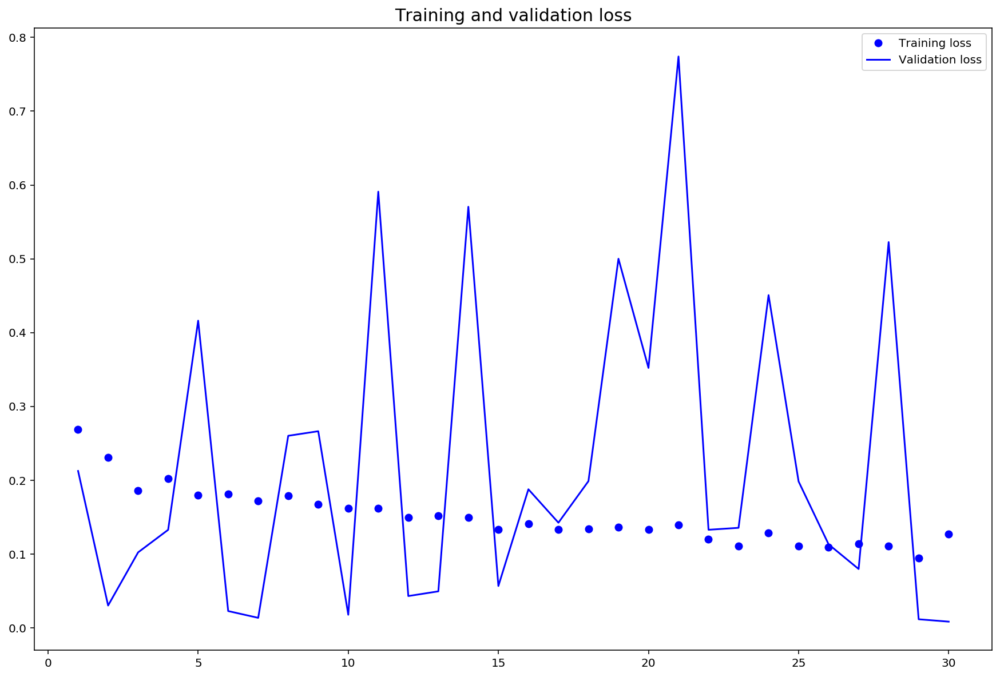

[0.0305621437728405, 0.9509999752044678]

In [29]:
conv_base.trainable = False

history5 = model_vgg16_tuned.fit_generator(
    augmented_train_generator,
    steps_per_epoch=100,
    epochs=30,
    validation_data=validation_generator,
    validation_steps=100)

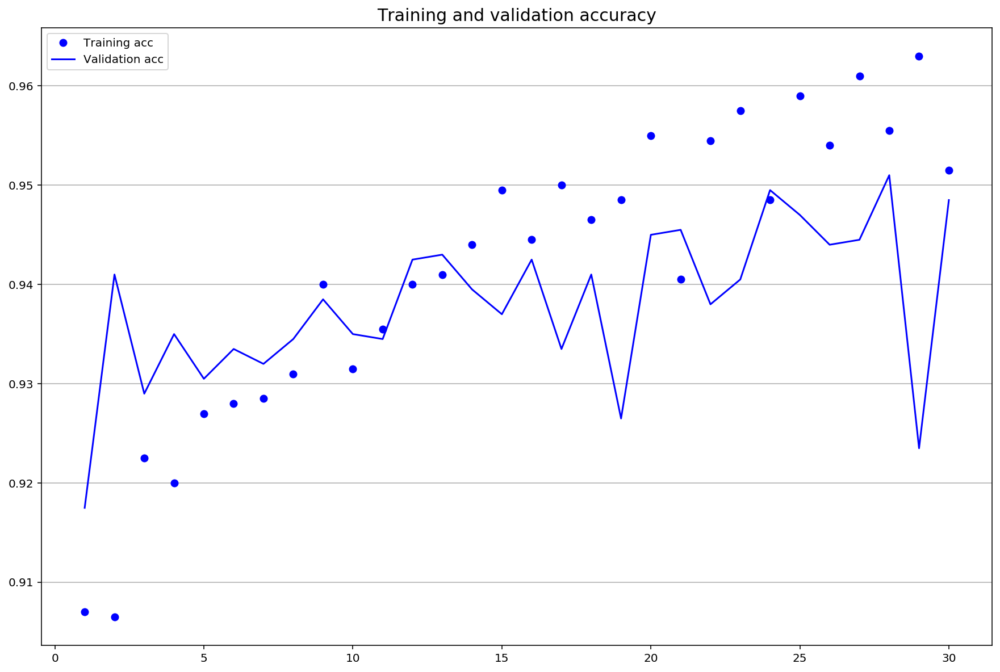

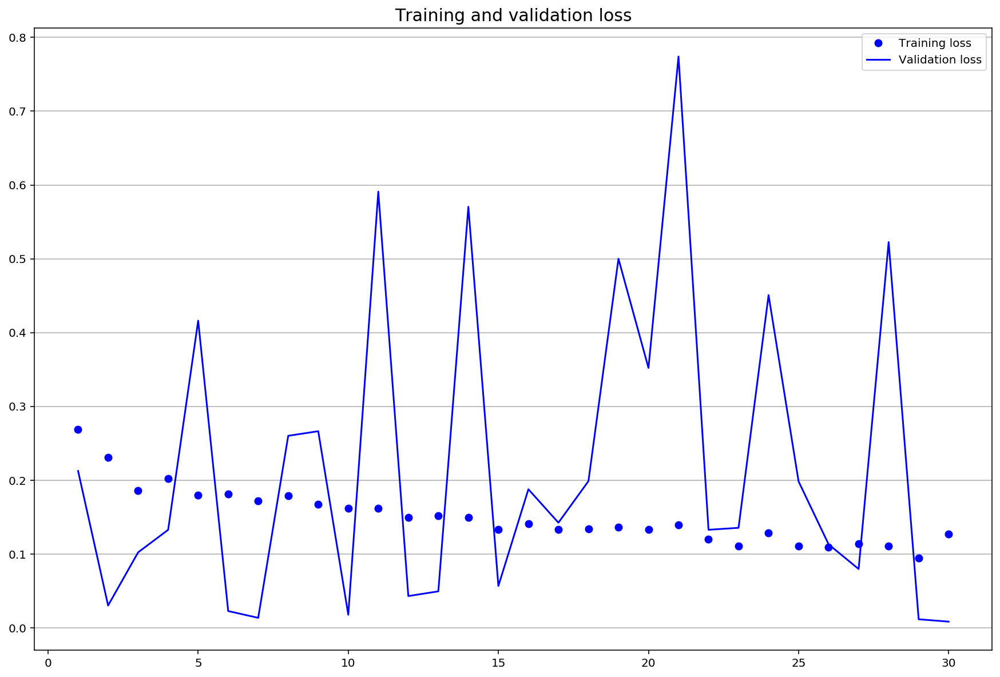

In [53]:
# Plot model performance
plot_model_performance(history5)

In [54]:
# Evaluate vgg16 fine-tuned model performance in test data
model_vgg16_tuned.evaluate_generator(test_generator, steps=100)

[0.0305621437728405, 0.9509999752044678]

In [55]:
# Save the tune model
model_vgg16_tuned.save('dogs_and_cats_subset_vgg16_tuned_with_augmented_data.h5')

<a id='2'></a>
## 2. Multiclass classification

<a id='2a'></a>
### (a) Download CIFAR-10

In [2]:
# The data, split between train, validation and test sets:
(X_train, y_train), (X_test, y_test) = cifar10.load_data()
X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, 
                                                      test_size=0.2, 
                                                      stratify=y_train, 
                                                      random_state=0)
print('X_train shape:', X_train.shape)
print(X_train.shape[0], 'train samples')
print(X_valid.shape[0], 'validation samples')
print(X_test.shape[0], 'test samples')

X_train shape: (40000, 32, 32, 3)
40000 train samples
10000 validation samples
10000 test samples


In [3]:
# Normaliza data
X_train = X_train.astype('float32') / 255.
X_valid = X_valid.astype('float32') / 255.
X_test = X_test.astype('float32') / 255.

In [4]:
# Convert class vectors to binary class matrices.
num_classes = 10
y_train = keras.utils.to_categorical(y_train, num_classes)
y_valid = keras.utils.to_categorical(y_valid, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)

<a id='2b'></a>
### (b) Build a basic convnet

In [5]:
def build_model(n_hidden_fc=512, dropout_rate=0.25, optimizer=RMSprop(learning_rate=1e-4, decay=1e-6)):
    model = Sequential([
        # CONV -> BN -> RELU
        Conv2D(32, 3, padding='same', input_shape=(32,32,3)),
        BatchNormalization(),
        Activation('relu'),
        
        # CONV -> BN -> RELU
        Conv2D(32, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),

        # MaxPOOL -> Dropout
        MaxPooling2D(2),
        Dropout(rate=dropout_rate),

        # CONV -> BN -> RELU
        Conv2D(64, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),
        
        # CONV -> BN -> RELU
        Conv2D(64, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),

        # MaxPOOL -> Dropout
        MaxPooling2D(2),
        Dropout(rate=dropout_rate),

        # FLATTEN -> FC -> DROUPOUT > SOFTMAX
        Flatten(),
        Dense(n_hidden_fc, activation='relu'),
        Dropout(rate=dropout_rate),
        Dense(10, activation='softmax')
    ])

    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['acc'])
    
    return model

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


In [95]:
model = build_model()
model.summary()

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_18 (Conv2D)           (None, 32, 32, 32)        896       
_________________________________________________________________
batch_normalization_18 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
activation_18 (Activation)   (None, 32, 32, 32)        0         
_________________________________________________________________
conv2d_19 (Conv2D)           (None, 32, 32, 32)        9248      
_________________________________________________________________
batch_normalization_19 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
activation_19 (Activation)   (None, 32, 32, 32)        0         
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 16, 16, 32)      

In [97]:
history6 = model.fit(X_train, y_train,
                     epochs=100,
                     batch_size=32,
                     validation_data=(X_valid, y_valid),
                     shuffle=True)

Train on 40000 samples, validate on 10000 samples
Epoch 1/100
40000/40000 [==============================] - 23s 574us/step - loss: 1.3485 - acc: 0.5132 - val_loss: 1.2071 - val_acc: 0.5755
Epoch 2/100
40000/40000 [==============================] - 23s 564us/step - loss: 1.2024 - acc: 0.5692 - val_loss: 1.0486 - val_acc: 0.6346
Epoch 3/100
40000/40000 [==============================] - 23s 564us/step - loss: 1.0934 - acc: 0.6133 - val_loss: 1.0231 - val_acc: 0.6445
Epoch 4/100
40000/40000 [==============================] - 22s 561us/step - loss: 1.0089 - acc: 0.6436 - val_loss: 0.9038 - val_acc: 0.6880
Epoch 5/100
40000/40000 [==============================] - 23s 578us/step - loss: 0.9437 - acc: 0.6647 - val_loss: 0.9429 - val_acc: 0.6767
Epoch 6/100
40000/40000 [==============================] - 24s 601us/step - loss: 0.8883 - acc: 0.6849 - val_loss: 0.8539 - val_acc: 0.7075
Epoch 7/100
40000/40000 [==============================] - 23s 563us/step - loss: 0.8511 - acc: 0.6999 - val_l

Epoch 59/100
40000/40000 [==============================] - 22s 560us/step - loss: 0.5063 - acc: 0.8306 - val_loss: 0.6122 - val_acc: 0.8015
Epoch 60/100
40000/40000 [==============================] - 22s 556us/step - loss: 0.5039 - acc: 0.8321 - val_loss: 0.6518 - val_acc: 0.7951
Epoch 61/100
40000/40000 [==============================] - 22s 555us/step - loss: 0.4982 - acc: 0.8324 - val_loss: 0.6721 - val_acc: 0.7869
Epoch 62/100
40000/40000 [==============================] - 22s 556us/step - loss: 0.4976 - acc: 0.8324 - val_loss: 0.6344 - val_acc: 0.7935
Epoch 63/100
40000/40000 [==============================] - 22s 556us/step - loss: 0.4945 - acc: 0.8342 - val_loss: 0.6866 - val_acc: 0.7755
Epoch 64/100
40000/40000 [==============================] - 22s 555us/step - loss: 0.4967 - acc: 0.8354 - val_loss: 0.6797 - val_acc: 0.7757
Epoch 65/100
40000/40000 [==============================] - 22s 558us/step - loss: 0.4951 - acc: 0.8346 - val_loss: 0.6133 - val_acc: 0.7999
Epoch 66/100


In [98]:
# Save the model
model.save('cifar10.h5')

<a id='2c'></a>
### (c) Evaluate model performance and fine-tuning

<a id='2c1'></a>
#### Evaluate performance

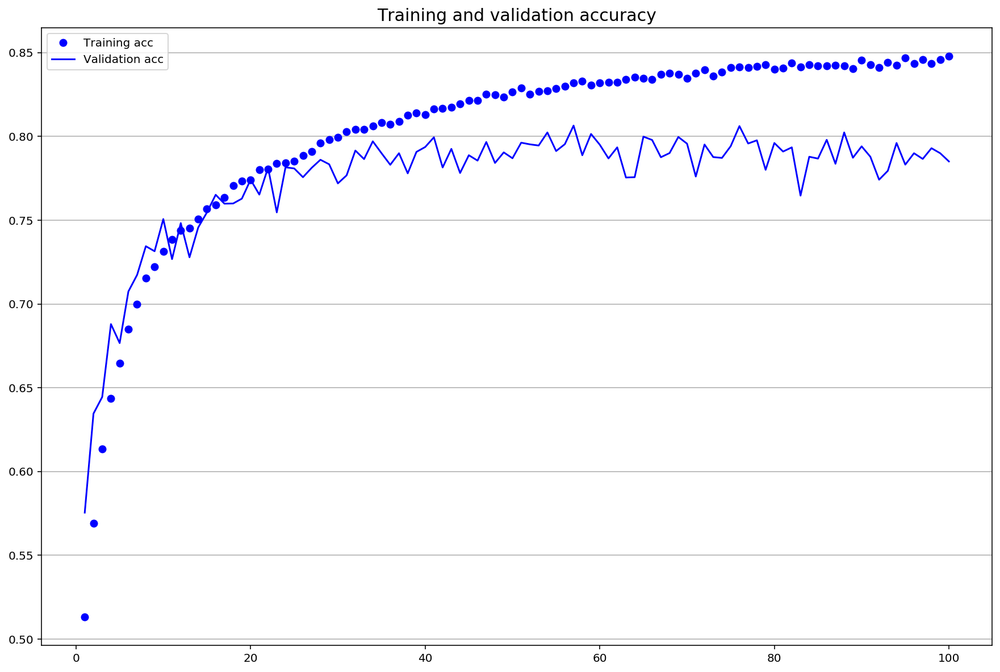

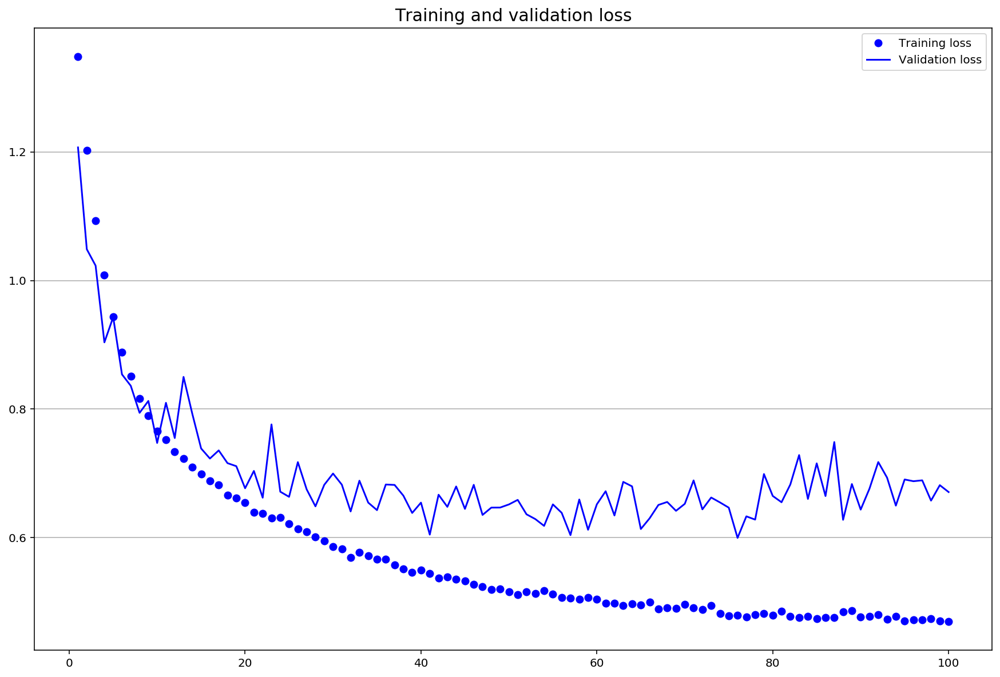

In [99]:
plot_model_performance(history6)

In [111]:
# Load cifar10 base model
try:
    model = load_model('cifar10.h5')
except:
    print('model does not exist')

In [112]:
model.evaluate(X_test, y_test)

10000/10000 [==============================] - 3s 250us/step


[0.677932357263565, 0.7870000004768372]

<a id='2c2'></a>
#### Fine-tune model

In [5]:
def build_model(n_hidden_fc1=512, 
                n_hidden_fc2=128, 
                dropout_rate=0.25, 
                optimizer=RMSprop(learning_rate=1e-4, decay=1e-6)):
    
    model = Sequential([
        # CONV -> BN -> RELU
        Conv2D(32, 3, padding='same', input_shape=(32,32,3)),
        BatchNormalization(),
        Activation('relu'),
        
        # CONV -> BN -> RELU
        Conv2D(32, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),

        # MaxPOOL -> Dropout
        MaxPooling2D(2),
        Dropout(rate=dropout_rate),

        # CONV -> BN -> RELU
        Conv2D(64, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),
        
        # CONV -> BN -> RELU
        Conv2D(64, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),

        # MaxPOOL -> Dropout
        MaxPooling2D(2),
        Dropout(rate=dropout_rate),
        
        # CONV -> BN -> RELU
        Conv2D(128, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),
        
        # CONV -> BN -> RELU
        Conv2D(128, 3, padding='same'),
        BatchNormalization(),
        Activation('relu'),

        # MaxPOOL -> Dropout
        MaxPooling2D(2),
        Dropout(rate=dropout_rate),

        # FLATTEN -> FC -> DROUPOUT > SOFTMAX
        Flatten(),
        Dense(n_hidden_fc1, activation='relu'),
        Dropout(rate=dropout_rate),
        Dense(n_hidden_fc2, activation='relu'),
        Dropout(rate=dropout_rate),
        Dense(10, activation='softmax')
    ])

    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['acc'])
    
    return model

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


In [103]:
model = build_model()

history7 = model.fit(X_train, y_train,
                     epochs=100,
                     batch_size=32,
                     validation_data=(X_valid, y_valid),
                     callbacks=[keras.callbacks.callbacks.EarlyStopping(patience=10)],
                     shuffle=True)

Train on 40000 samples, validate on 10000 samples
Epoch 1/100
40000/40000 [==============================] - 28s 699us/step - loss: 1.8797 - acc: 0.3090 - val_loss: 1.5861 - val_acc: 0.4206
Epoch 2/100
40000/40000 [==============================] - 26s 652us/step - loss: 1.5060 - acc: 0.4482 - val_loss: 1.5253 - val_acc: 0.4653
Epoch 3/100
40000/40000 [==============================] - 27s 685us/step - loss: 1.3697 - acc: 0.5081 - val_loss: 1.4853 - val_acc: 0.4884
Epoch 4/100
40000/40000 [==============================] - 27s 666us/step - loss: 1.2528 - acc: 0.5518 - val_loss: 1.2589 - val_acc: 0.5637
Epoch 5/100
40000/40000 [==============================] - 26s 657us/step - loss: 1.1588 - acc: 0.5875 - val_loss: 1.0965 - val_acc: 0.6113
Epoch 6/100
40000/40000 [==============================] - 27s 674us/step - loss: 1.0817 - acc: 0.6155 - val_loss: 1.2280 - val_acc: 0.6015
Epoch 7/100
40000/40000 [==============================] - 26s 662us/step - loss: 1.0192 - acc: 0.6403 - val_l

In [105]:
model = build_model()

history7 = model.fit(X_train, y_train,
                     epochs=39,
                     batch_size=32,
                     validation_data=(X_valid, y_valid),
                     shuffle=True)

Train on 40000 samples, validate on 10000 samples
Epoch 1/39
40000/40000 [==============================] - 29s 722us/step - loss: 1.8894 - acc: 0.2997 - val_loss: 1.7473 - val_acc: 0.3512
Epoch 2/39
40000/40000 [==============================] - 26s 660us/step - loss: 1.5556 - acc: 0.4274 - val_loss: 1.5211 - val_acc: 0.4679
Epoch 3/39
40000/40000 [==============================] - 27s 668us/step - loss: 1.3963 - acc: 0.4960 - val_loss: 1.3355 - val_acc: 0.5309
Epoch 4/39
40000/40000 [==============================] - 26s 648us/step - loss: 1.2796 - acc: 0.5396 - val_loss: 1.2274 - val_acc: 0.5677
Epoch 5/39
40000/40000 [==============================] - 27s 671us/step - loss: 1.1886 - acc: 0.5813 - val_loss: 1.2563 - val_acc: 0.5642
Epoch 6/39
40000/40000 [==============================] - 27s 673us/step - loss: 1.1125 - acc: 0.6039 - val_loss: 1.0030 - val_acc: 0.6467
Epoch 7/39
40000/40000 [==============================] - 26s 655us/step - loss: 1.0501 - acc: 0.6271 - val_loss: 1.

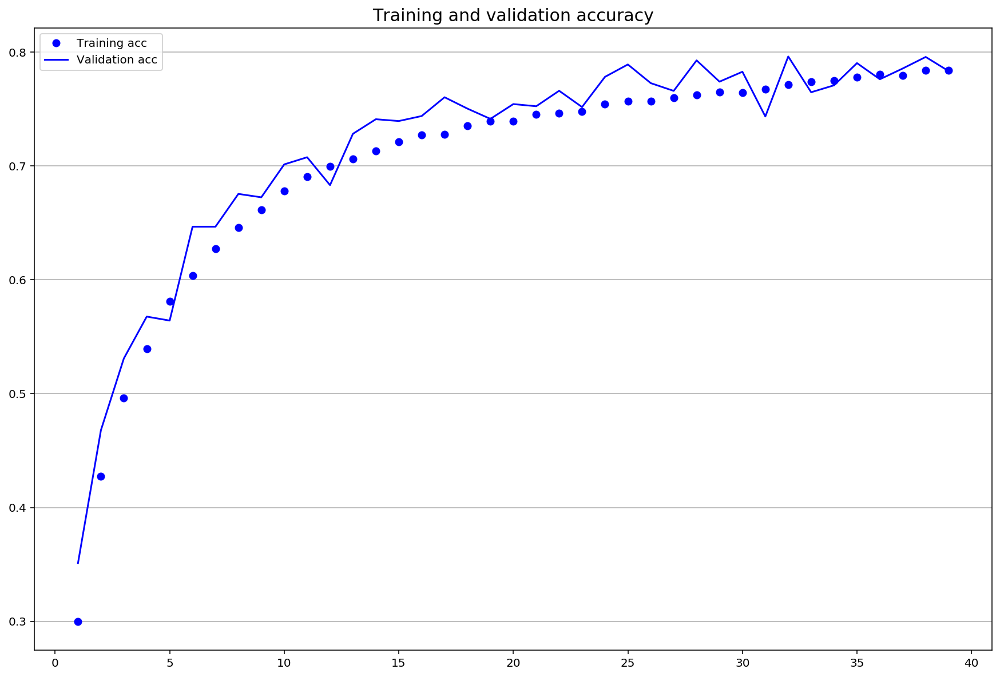

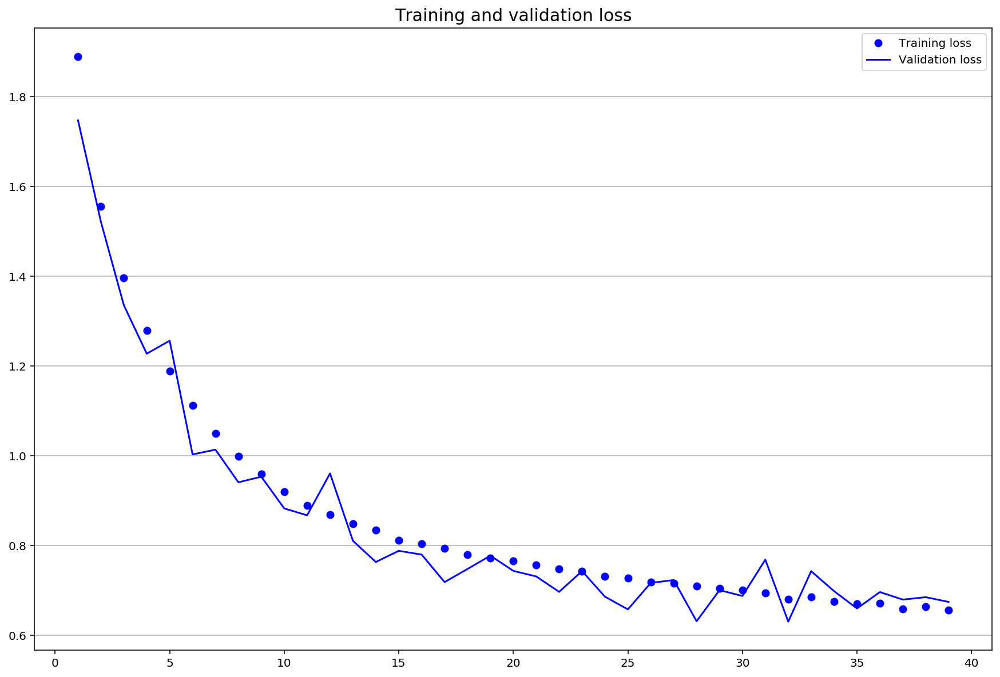

In [107]:
plot_model_performance(history7)

In [108]:
# Save the model
model.save('cifar10_tuned.h5')

In [110]:
model.evaluate(X_test, y_test)

10000/10000 [==============================] - 2s 225us/step


[0.6758345122337341, 0.7806000113487244]

<a id='2d'></a>
### (d) Add inception blocks

In [13]:
def GoogleNet(input_shape=(32,32,3), 
              num_classes=10,  
              n_hidden_fc1=512, 
              n_hidden_fc2=128,
              dropout_rate=0.25, 
              optimizer=RMSprop(learning_rate=1e-4, decay=1e-6)):
    """
    Implement one inception block.
    """
    
    # Define the input
    X_input = Input(input_shape)
    
    # CONV -> BN -> RELU
    X = Conv2D(32, 3, padding='same', name='conv1')(X_input)
    X = BatchNormalization(axis=-1, name='bn_conv1')(X)
    X = Activation('relu')(X)

    # CONV -> BN -> RELU
    X = Conv2D(32, 3, padding='same', name='conv2')(X)
    X = BatchNormalization(axis=-1, name='bn_conv2')(X)
    X = Activation('relu')(X)

    # MaxPOOL -> Dropout
    X = MaxPooling2D(2)(X)
    X = Dropout(rate=dropout_rate)(X)

    # CONV -> BN -> RELU
    X = Conv2D(64, 3, padding='same', name='conv3')(X)
    X = BatchNormalization(axis=-1, name='bn_conv3')(X)
    X = Activation('relu')(X)

    # CONV -> BN -> RELU
    X = Conv2D(64, 3, padding='same', name='conv4')(X)
    X = BatchNormalization(axis=-1, name='bn_conv4')(X)
    X = Activation('relu')(X)

    # MaxPOOL -> Dropout
    X = MaxPooling2D(2)(X)
    X = Dropout(rate=dropout_rate)(X)
    
    # CONV -> BN -> RELU
    X = Conv2D(128, 3, padding='same')(X)
    X = BatchNormalization()(X)
    X = Activation('relu')(X)

    # CONV -> BN -> RELU
    X = Conv2D(128, 3, padding='same')(X)
    X = BatchNormalization()(X)
    X = Activation('relu')(X)

    # MaxPOOL -> Dropout
    X = MaxPooling2D(2)(X)
    X = Dropout(rate=dropout_rate)(X)
    
    # CONV, CONV -> CONV, AVGPOOL -> CONV, CONV -> CONV -> CONV
    a = Conv2D(44, 1, activation='relu', strides=2, name='inception1_branch_a')(X)
    b = Conv2D(44, 1, activation='relu', strides=1, name='inception1_branch_b_1')(X)
    b = Conv2D(44, 2, activation='relu', strides=2, padding='valid', name='inception1_branch_b_2')(b)
    c = AveragePooling2D(2, strides=2, padding='same', name='inception1_branch_c_1')(X)
    c = Conv2D(44, 1, activation='relu', strides=1, name='inception1_branch_c_2')(c)
    d = Conv2D(44, 1, activation='relu', strides=1, name='inception1_branch_d_1')(X)
    d = Conv2D(44, 1, activation='relu', strides=2, padding='same', name='inception1_branch_d_2')(d)
    X = keras.layers.concatenate([a, b, c, d], axis=-1)

    # FLATTEN -> FC -> DROUPOUT > SOFTMAX
    X = Flatten()(X)
    X = Dense(n_hidden_fc1, activation='relu')(X)
    X = Dropout(rate=dropout_rate)(X)
    X = Dense(n_hidden_fc2, activation='relu')(X)
    X = Dropout(rate=dropout_rate)(X)
    X = Dense(10, activation='softmax')(X)
    
    # Create model
    model = Model(inputs=X_input, outputs=X, name='GoogleNet')
    
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['acc'])

    return model

In [14]:
model = GoogleNet()
model.summary()

Model: "GoogleNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 32, 32, 3)    0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 32, 32, 32)   896         input_6[0][0]                    
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 32, 32, 32)   128         conv1[0][0]                      
__________________________________________________________________________________________________
activation_31 (Activation)      (None, 32, 32, 32)   0           bn_conv1[0][0]                   
__________________________________________________________________________________________

In [15]:
model = GoogleNet()

history9 = model.fit(X_train, y_train,
                     epochs=39,
                     batch_size=32,
                     validation_data=(X_valid, y_valid),
                     shuffle=True)

Train on 40000 samples, validate on 10000 samples
Epoch 1/39
40000/40000 [==============================] - 247s 6ms/step - loss: 1.8651 - acc: 0.3020 - val_loss: 1.6874 - val_acc: 0.3710
Epoch 2/39
40000/40000 [==============================] - 254s 6ms/step - loss: 1.4995 - acc: 0.4470 - val_loss: 1.4985 - val_acc: 0.4621
Epoch 3/39
40000/40000 [==============================] - 254s 6ms/step - loss: 1.3417 - acc: 0.5134 - val_loss: 1.7860 - val_acc: 0.4159
Epoch 4/39
40000/40000 [==============================] - 254s 6ms/step - loss: 1.2232 - acc: 0.5603 - val_loss: 1.1698 - val_acc: 0.5943
Epoch 5/39
40000/40000 [==============================] - 255s 6ms/step - loss: 1.1200 - acc: 0.5974 - val_loss: 1.2164 - val_acc: 0.5749
Epoch 6/39
40000/40000 [==============================] - 255s 6ms/step - loss: 1.0512 - acc: 0.6266 - val_loss: 0.9665 - val_acc: 0.6624
Epoch 7/39
40000/40000 [==============================] - 255s 6ms/step - loss: 0.9995 - acc: 0.6458 - val_loss: 0.9364 - 

In [16]:
model.save('GoogleNet.h5')

In [ ]:
plot_model_performance(history9)

In [24]:
try:
    model = load_model('GoogleNet.h5')
except:
    print('Model does not exist')

In [25]:
model.evaluate(X_test, y_test)

10000/10000 [==============================] - 14s 1ms/step


[0.6707640866279602, 0.7810999751091003]

<a id='2e'></a>
### (e) Add residual blocks

In [17]:
def ResNet(input_shape=(32,32,3), 
           num_classes=10, 
           n_hidden_fc1=512, 
           n_hidden_fc2=128,
           dropout_rate=0.25, 
           optimizer=RMSprop(learning_rate=1e-4, decay=1e-6)):
    """
    Implement one residual block.
    """
    
    # Define the input
    X_input = Input(input_shape)
    
    # CONV -> BN -> RELU
    X = Conv2D(32, 3, padding='same', name='conv1')(X_input)
    X = BatchNormalization(axis=-1, name='bn_conv1')(X)
    X = Activation('relu')(X)

    # CONV -> BN -> RELU
    X = Conv2D(32, 3, padding='same', name='conv2')(X)
    X = BatchNormalization(axis=-1, name='bn_conv2')(X)
    X = Activation('relu')(X)

    # MaxPOOL -> Dropout
    X = MaxPooling2D(2)(X)
    X = Dropout(rate=dropout_rate)(X)

    # CONV -> BN -> RELU
    X_shortcut = X
    X = Conv2D(64, 3, padding='same', name='conv3')(X)
    X = BatchNormalization(axis=-1, name='bn_conv3')(X)
    X = Activation('relu')(X)

    # CONV -> BN -> + RES -> RELU
    X = Conv2D(64, 3, padding='same', name='conv4')(X)
    X = BatchNormalization(axis=-1, name='bn_conv4')(X)
    X_shortcut = Conv2D(64, 1, strides=1, name='res_1')(X_shortcut)
    X_shortcut = BatchNormalization(axis=-1, name='bn_res_1')(X_shortcut)
    X = Add()([X, X_shortcut])
    X = Activation('relu')(X)

    # MaxPOOL -> Dropout
    X = MaxPooling2D(2)(X)
    X = Dropout(rate=dropout_rate)(X)

    # CONV -> BN -> RELU
    X_shortcut = X
    X = Conv2D(128, 3, padding='same')(X)
    X = BatchNormalization()(X)
    X = Activation('relu')(X)

    # CONV -> BN -> RELU
    X = Conv2D(128, 3, padding='same')(X)
    X = BatchNormalization()(X)
    X_shortcut = Conv2D(128, 1, strides=1, name='res_2')(X_shortcut)
    X_shortcut = BatchNormalization(axis=-1, name='bn_res_2')(X_shortcut)
    X = Add()([X, X_shortcut])
    Activation('relu')(X)

    # MaxPOOL -> Dropout
    X = MaxPooling2D(2)(X)
    X = Dropout(rate=dropout_rate)(X)

    # FLATTEN -> FC -> DROUPOUT > SOFTMAX
    X = Flatten()(X)
    X = Dense(n_hidden_fc1, activation='relu')(X)
    X = Dropout(rate=dropout_rate)(X)
    X = Dense(n_hidden_fc2, activation='relu')(X)
    X = Dropout(rate=dropout_rate)(X)
    X = Dense(10, activation='softmax')(X)
    
    # Create model
    model = Model(inputs=X_input, outputs=X, name='ResNet')
    
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['acc'])

    return model

In [18]:
model = ResNet()
model.summary()

Model: "ResNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            (None, 32, 32, 3)    0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 32, 32, 32)   896         input_8[0][0]                    
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 32, 32, 32)   128         conv1[0][0]                      
__________________________________________________________________________________________________
activation_43 (Activation)      (None, 32, 32, 32)   0           bn_conv1[0][0]                   
_____________________________________________________________________________________________

In [19]:
model = ResNet()

history8 = model.fit(X_train, y_train,
                     epochs=39,
                     batch_size=32,
                     validation_data=(X_valid, y_valid),
                     shuffle=True)

Train on 40000 samples, validate on 10000 samples
Epoch 1/39
40000/40000 [==============================] - 271s 7ms/step - loss: 1.9547 - acc: 0.2936 - val_loss: 1.8404 - val_acc: 0.3674
Epoch 2/39
40000/40000 [==============================] - 268s 7ms/step - loss: 1.5966 - acc: 0.4207 - val_loss: 1.5144 - val_acc: 0.4822
Epoch 3/39
40000/40000 [==============================] - 269s 7ms/step - loss: 1.4429 - acc: 0.4797 - val_loss: 1.4628 - val_acc: 0.5249
Epoch 4/39
40000/40000 [==============================] - 269s 7ms/step - loss: 1.3249 - acc: 0.5256 - val_loss: 1.4689 - val_acc: 0.5402
Epoch 5/39
40000/40000 [==============================] - 268s 7ms/step - loss: 1.2308 - acc: 0.5610 - val_loss: 1.5153 - val_acc: 0.5552
Epoch 6/39
40000/40000 [==============================] - 268s 7ms/step - loss: 1.1671 - acc: 0.5831 - val_loss: 1.2903 - val_acc: 0.5923
Epoch 7/39
40000/40000 [==============================] - 269s 7ms/step - loss: 1.1087 - acc: 0.6107 - val_loss: 1.2305 - 

In [20]:
model.save('ResNet.h5')

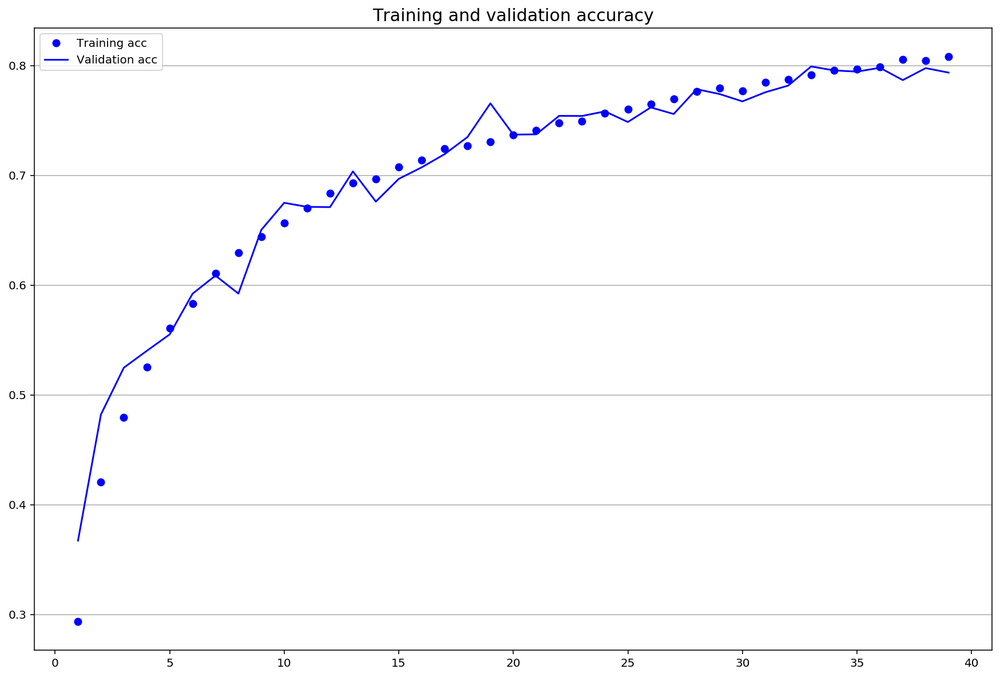

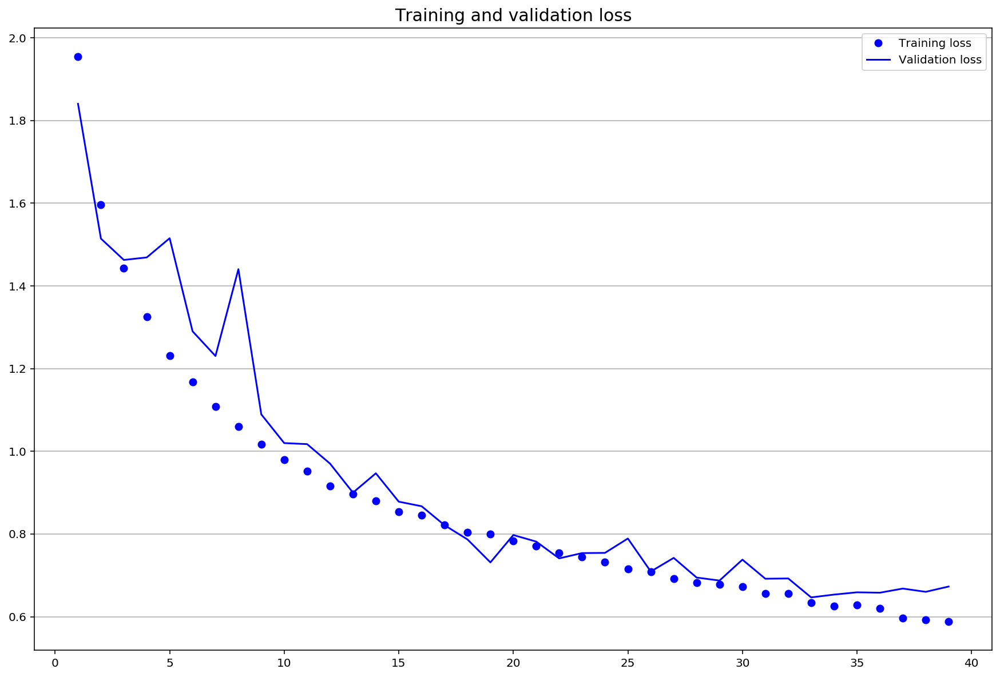

In [22]:
plot_model_performance(history8)

In [23]:
model.evaluate(X_test, y_test)

10000/10000 [==============================] - 15s 2ms/step


[0.6849432789802551, 0.7954999804496765]